<a href="https://colab.research.google.com/github/SarraLKSC/Salamander_Individual_Identification/blob/main/Notebooks/segmentation_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **READ ME:**

Ce notebook permet d'utiliser le modèle de segmentation de salamandres sur des images d'observations. Afin d'extraire le corps des salamandres présentes sur les images, il suffit d'importer les images dans le dossier **"images"** du drive avant d'exécuter la totalité des cellules de code ci-dessous.

Les images admises par le modèle doivent inclure une seule salamandre, orientée de façon à avoir la tête vers le haut.

Avant de lancer le code, on peut voir plus bas un exemple de résultats produits par le modèle IA. Sur ces visualisations, on a à gauche l'image récupérée du dossier et à droite le corps de la salamandre extrait. Ces images de droite sont sauvegardées et disponibles au téléchargement dans le fichier zip de nom **"segmentation_salamandres.zip"**.


* **MODIFICATION:** La cellule de code numéro 3 débutant par le commentaire "-MODIFICATION-" reprend les liens d'accès aux images et au modèle. En cas d'erreur "no such file or directory", vérifiez que les liens repris dans cette cellule sont bien en accord avec la localisation des fichiers dans le drive. Le dossier partagé "Segmentation_de_salamandre" est automatiquement répertorié dans les dossiers "partagés avec moi" du drive. Assurez-vous qu'il est disponible dans "Mon Drive". Pour ce faire, il suffit de créer un raccourci de "Segmentation_de_salamandre" dans "Mon Drive".

* **EXECUTION:** Toutes les cellules doivent être exécutées afin de récupérer les images souhaitées. Pour ce faire, vous pouvez soit (1) les exécuter une par une dans le bon ordre en cliquant sur le bouton "run" qui apparaît lorsque vous placez le curseur sur le coin haut-gauche de la cellule marquée par [ ], soit (2) tout exécuter en cliquant sur *$"Runtime"$* -> *$"Run all"$* dans la barre de menus.

* **TELECHARGEMENT:** Afin de récupérer les images produites par le modèle IA, il suffit de télécharger le fichier zip précédemment mentionné. Celui-ci peut être téléchargé à partir de l'onglet "Fichiers" à gauche de l'interface en cliquant sur l'icône de dossier. Une fois dans l'onglet "Fichiers", placez le curseur sur le fichier zip et cliquez sur les trois points qui apparaissent, puis cliquez sur "Télécharger".

In [ ]:
#import dependencies
!pip3 install pillow-heif
import os
import cv2
import numpy as np
from PIL import Image
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras import backend as K
from pillow_heif import register_heif_opener
from tensorflow.keras.models import load_model
from skimage.measure import label, regionprops, regionprops_table

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 7.7 MB/s eta 0:00:00


In [ ]:
#load data from "images" directory
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#-MODIFICATION-
root_path="/content/drive/MyDrive/Segmentation_de_salamandre/images/"
model_path="/content/drive/MyDrive/Segmentation_de_salamandre/u_net_upright_data-2.h5"

images =[root_path+ doc for doc in os.listdir(root_path)]
register_heif_opener()

In [ ]:
# Define custom loss function
def dice_coef(y_true, y_pred):
    """ Dice's coefficient
    Args:
        y_true: correct mask of the salamander
        y_pred: predicted mask of the salamander
    """
    smooth = 10.
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def dice_coef_loss(y_true, y_pred):
    """ Dice's loss
    Args:
        y_true: correct mask of the salamander
        y_pred: predicted mask of the salamander
    """
    return 1 - dice_coef(y_true, y_pred)

# Load the saved model and specify the custom loss function
with tf.keras.utils.custom_object_scope({'dice_coef_loss': dice_coef_loss, 'dice_coef': dice_coef}):
    loaded_model = load_model( model_path)


In [ ]:
def non_stretching_resize(img,cmap,desired_size=256):

    old_size= img.size
    ratio= float(desired_size)/max(old_size)
    new_size =tuple([int(x * ratio) for x in old_size])

    im = img.resize(new_size, Image.ANTIALIAS)

    new_im = Image.new(cmap, (desired_size, desired_size))
    new_im.paste(im, ((desired_size - new_size[0]) // 2,
                          (desired_size - new_size[1]) // 2))

    img_array=np.asarray(new_im)/255.
    return new_im
def remove_outliers(mask, min_size=100):
    mask = (mask * 255).astype(np.uint8)

    # Find connected components in the mask
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(mask, connectivity=8)

    # Filter out small regions
    filtered_mask = np.zeros_like(mask)
    for label in range(1, num_labels):
        area = stats[label, cv2.CC_STAT_AREA]
        if area >= min_size:
            filtered_mask[labels == label] = 255

    return filtered_mask
def dilation(msk):
    msk = (msk * 255).astype(np.uint8)

    disk = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    img = cv2.dilate(msk, disk)

    return img

def make_dataset():
  x = []
  for i,image in enumerate(images):
    print("\r"+str(i)+"/"+str(len(images)),end="")
    if image==".DS_Store":
      print('found the impostor')
      pass
    image = Image.open(os.path.join(root_path,image))#.convert('L')
    image = np.asarray(non_stretching_resize(image,"RGB"))/255.
    x.append(image)
  return np.array(x)
data= make_dataset()
!mkdir /content/prediction_img
!mkdir /content/rectangle_img


0/112

<ipython-input-5-38a9e0217a78>:7: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  im = img.resize(new_size, Image.ANTIALIAS)


111/112

1/1 [==============================] - 2s 2s/step


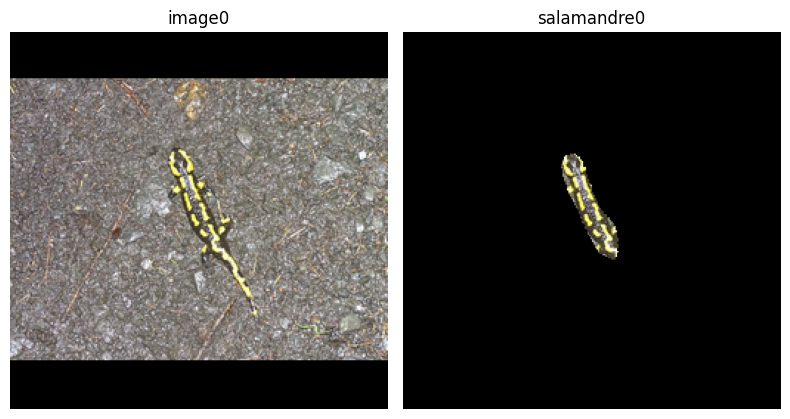

1/1 [==============================] - 2s 2s/step


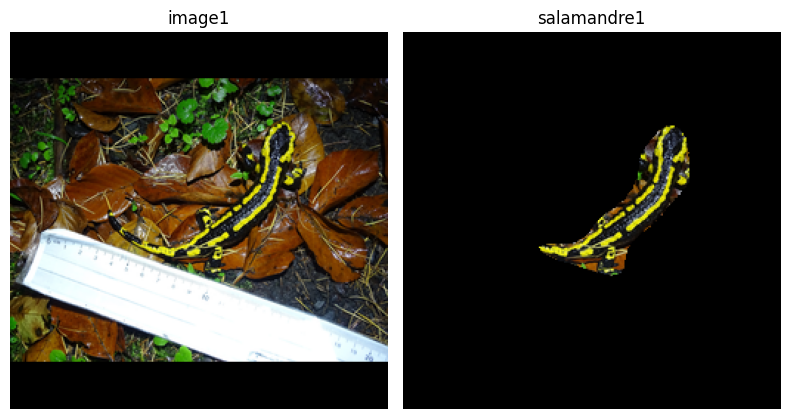

1/1 [==============================] - 2s 2s/step


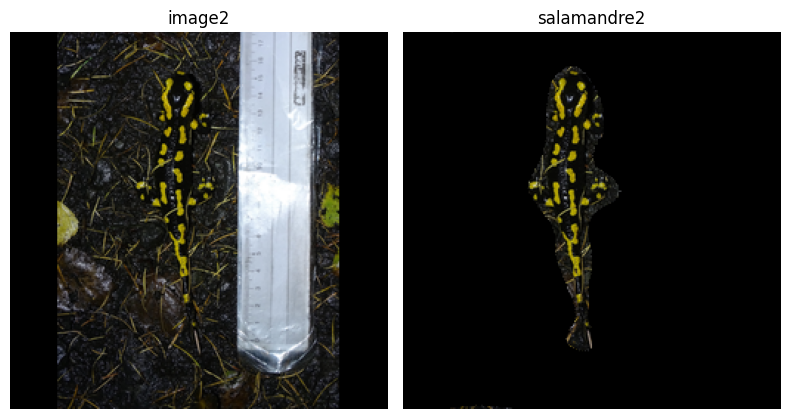

1/1 [==============================] - 3s 3s/step


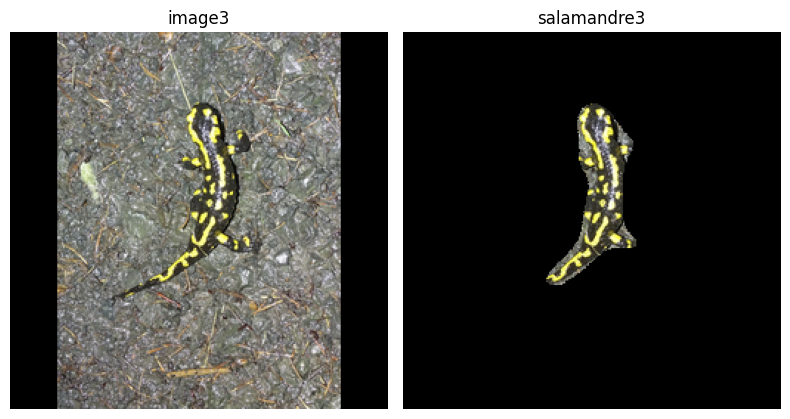

1/1 [==============================] - 3s 3s/step


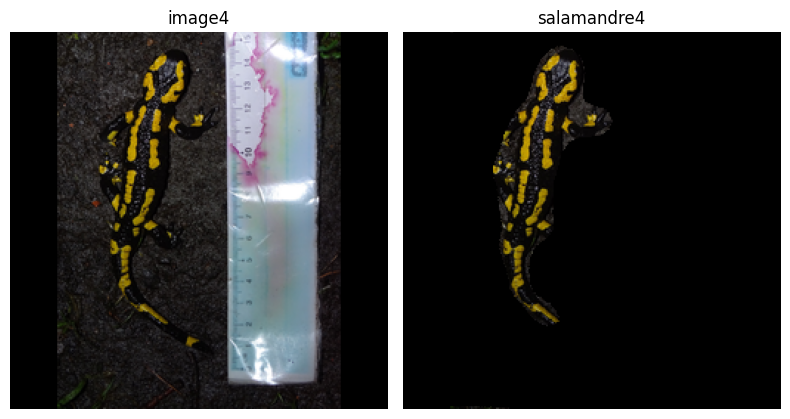

1/1 [==============================] - 2s 2s/step


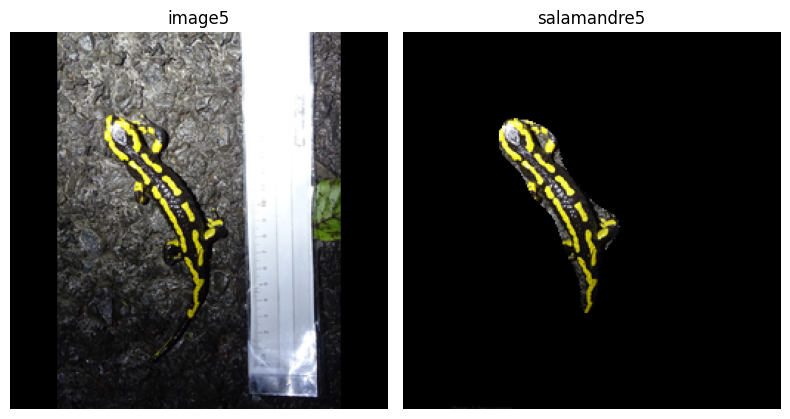

1/1 [==============================] - 2s 2s/step


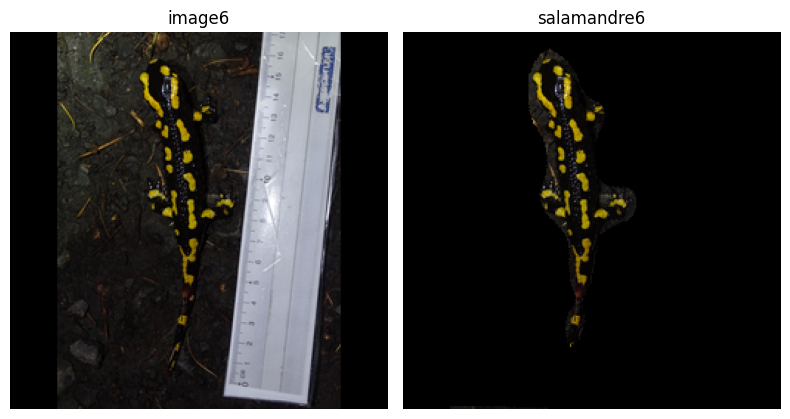

1/1 [==============================] - 2s 2s/step


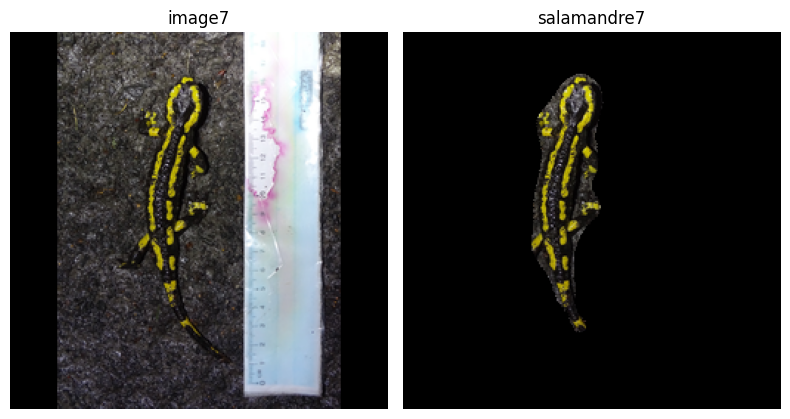

1/1 [==============================] - 2s 2s/step


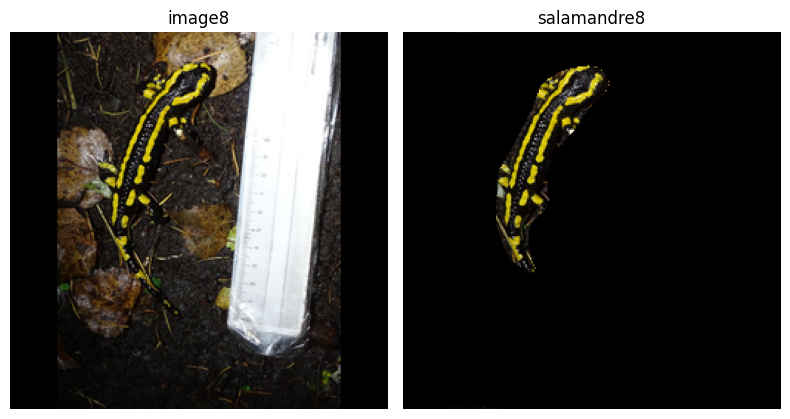

1/1 [==============================] - 4s 4s/step


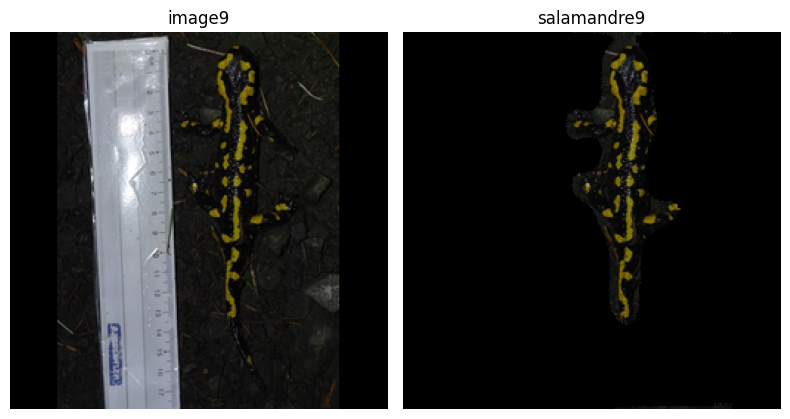

1/1 [==============================] - 2s 2s/step


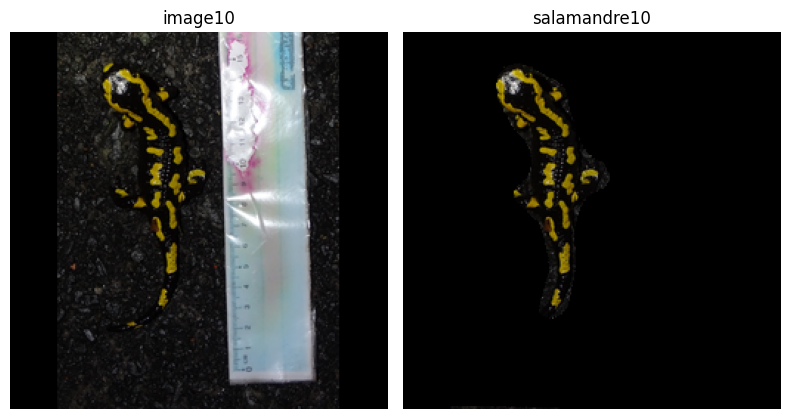

1/1 [==============================] - 2s 2s/step


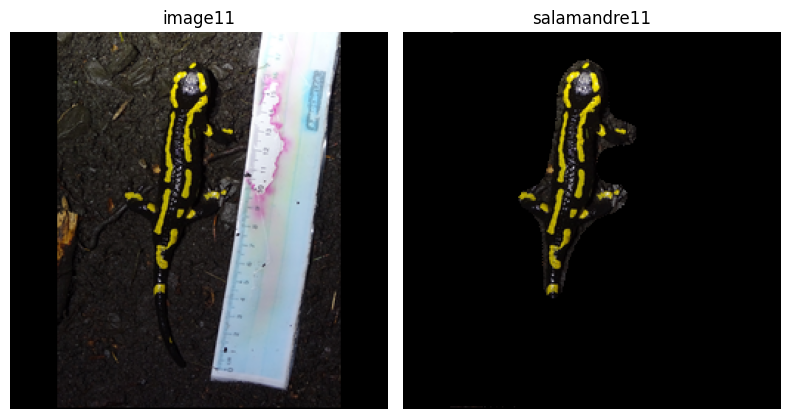

1/1 [==============================] - 2s 2s/step


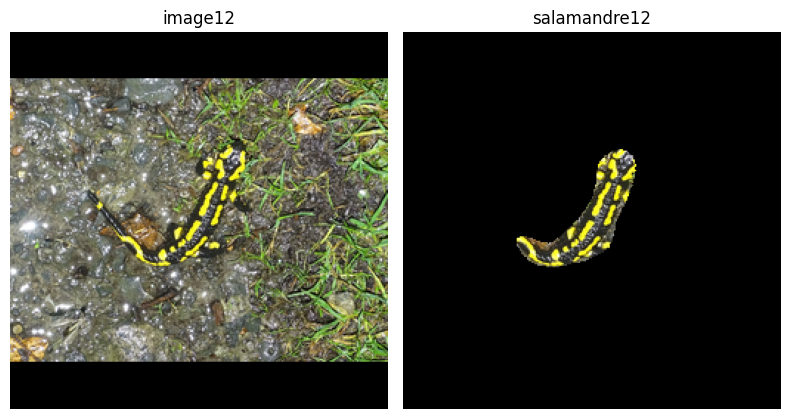

1/1 [==============================] - 2s 2s/step


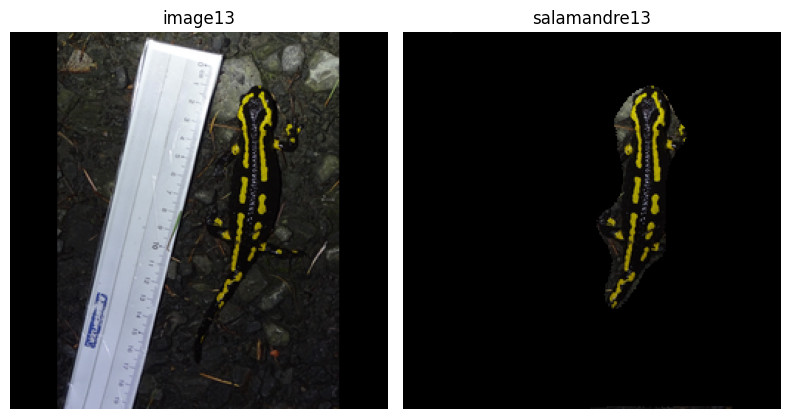

1/1 [==============================] - 3s 3s/step


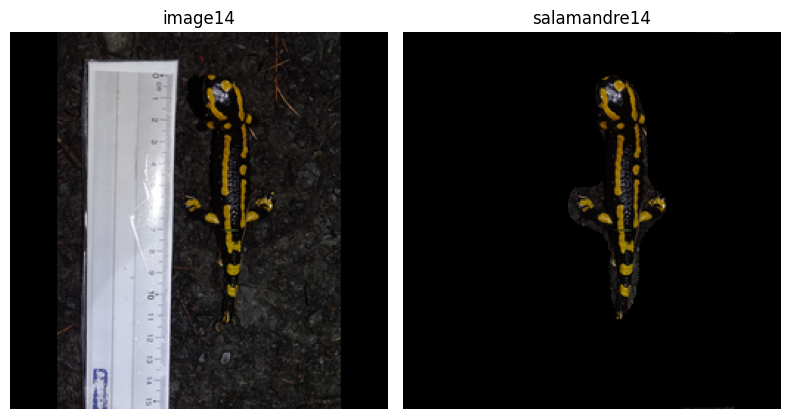

1/1 [==============================] - 3s 3s/step


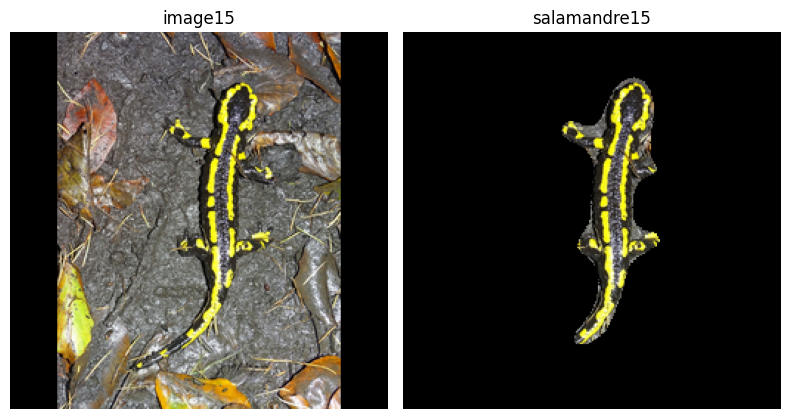

1/1 [==============================] - 2s 2s/step


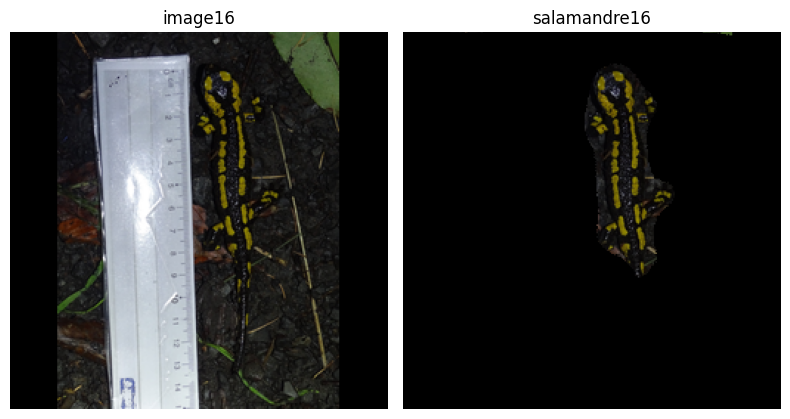

1/1 [==============================] - 2s 2s/step


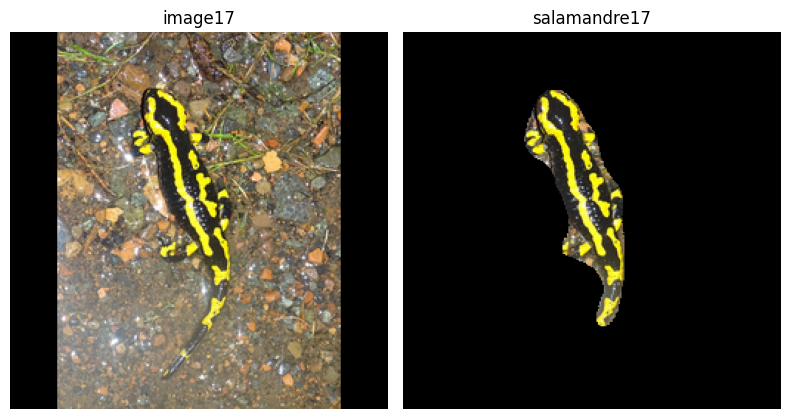

1/1 [==============================] - 2s 2s/step


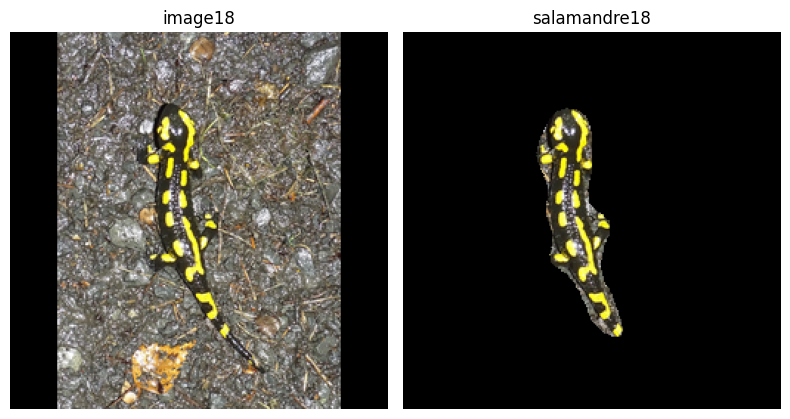

1/1 [==============================] - 3s 3s/step


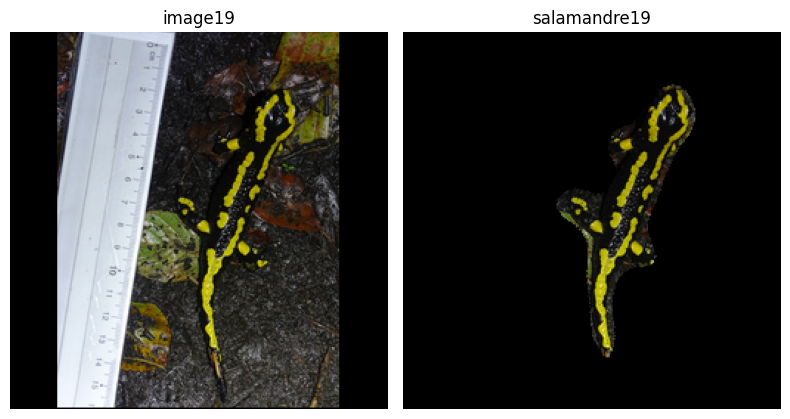

1/1 [==============================] - 3s 3s/step


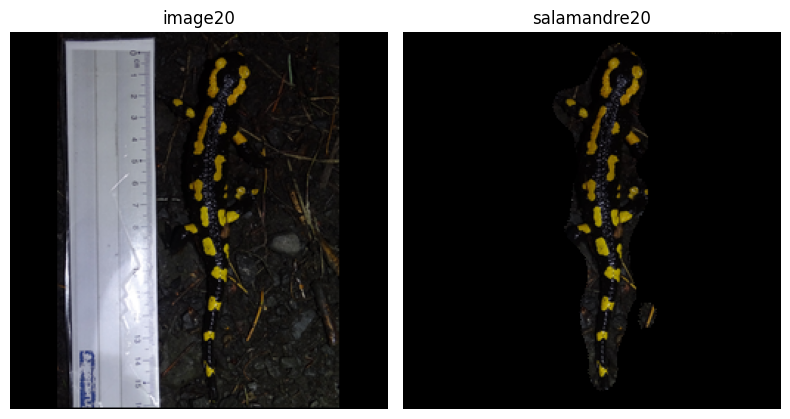

1/1 [==============================] - 2s 2s/step


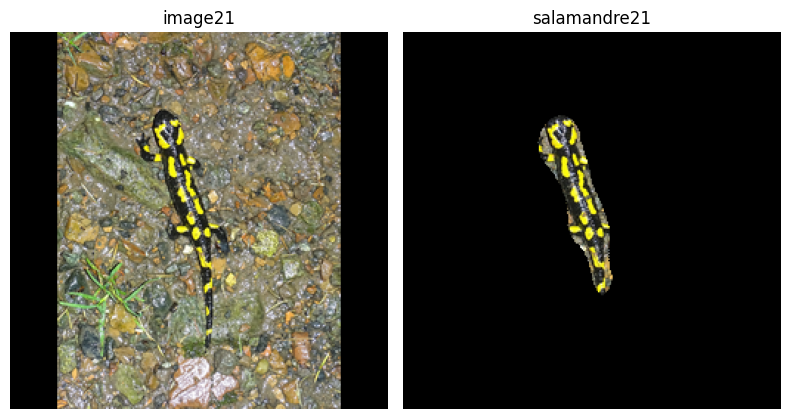

1/1 [==============================] - 2s 2s/step


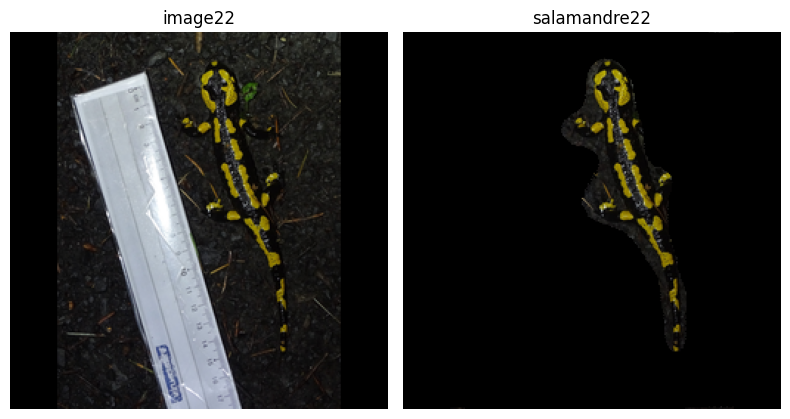

1/1 [==============================] - 2s 2s/step


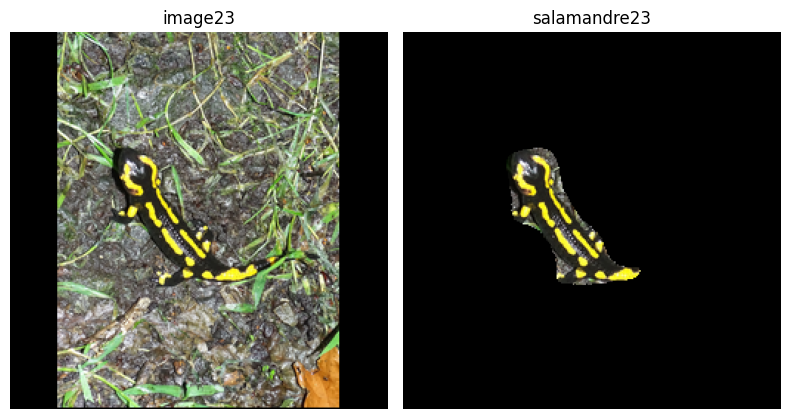

1/1 [==============================] - 2s 2s/step


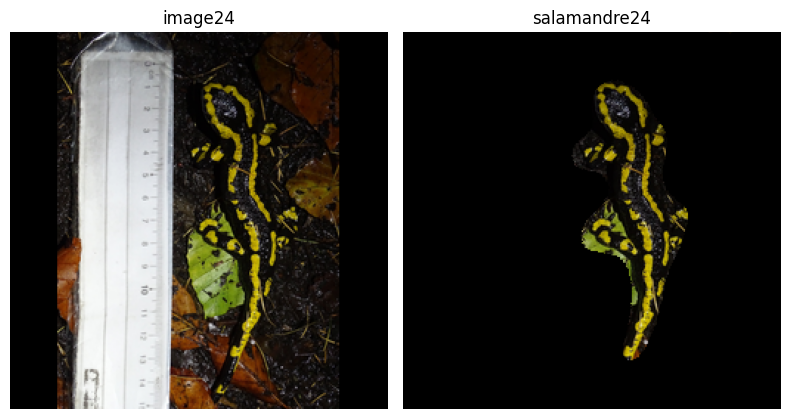

1/1 [==============================] - 3s 3s/step


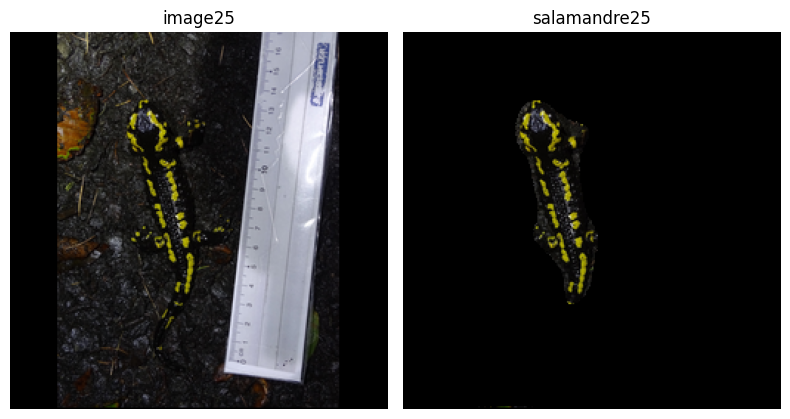

1/1 [==============================] - 2s 2s/step


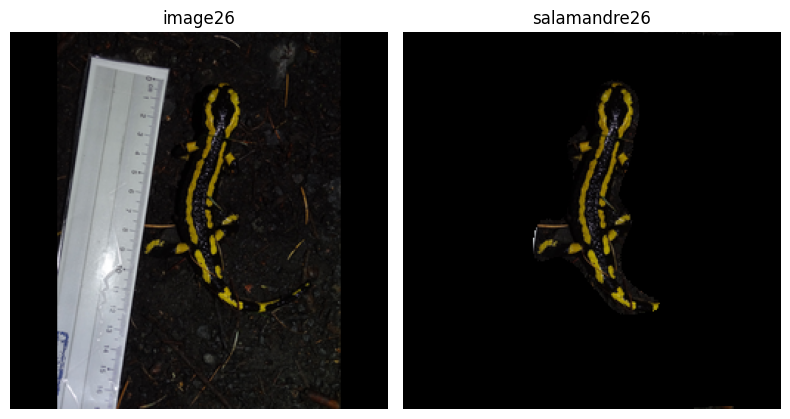

1/1 [==============================] - 3s 3s/step


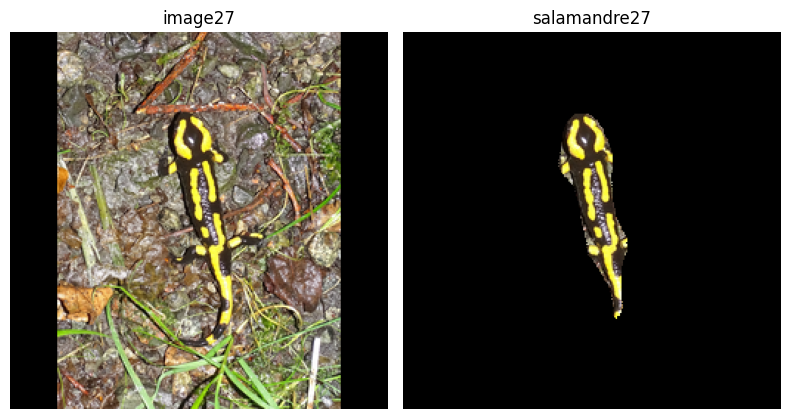

1/1 [==============================] - 2s 2s/step


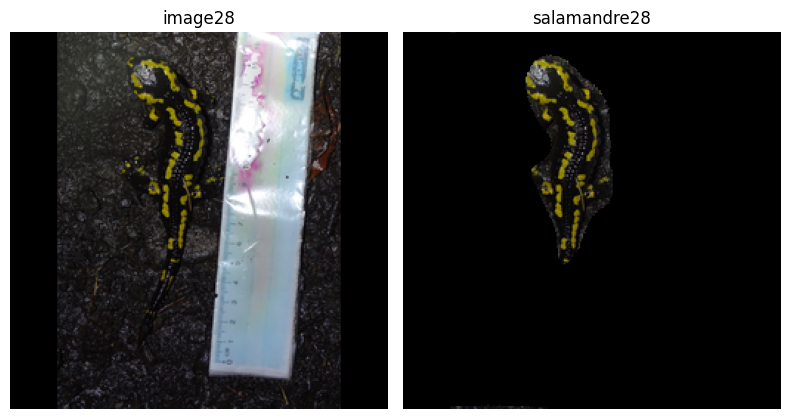

1/1 [==============================] - 2s 2s/step


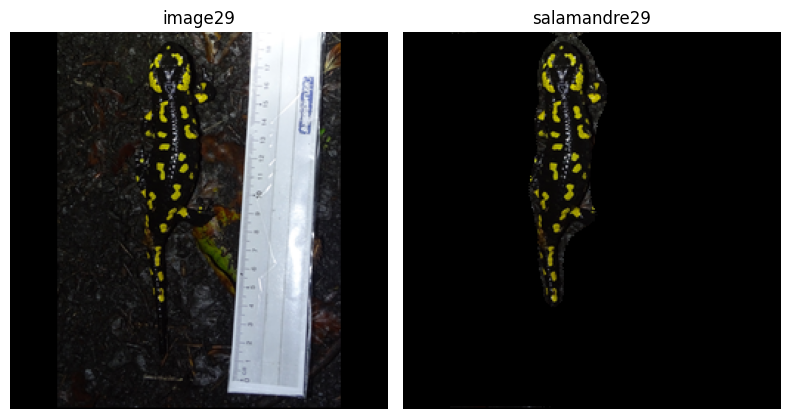

1/1 [==============================] - 4s 4s/step


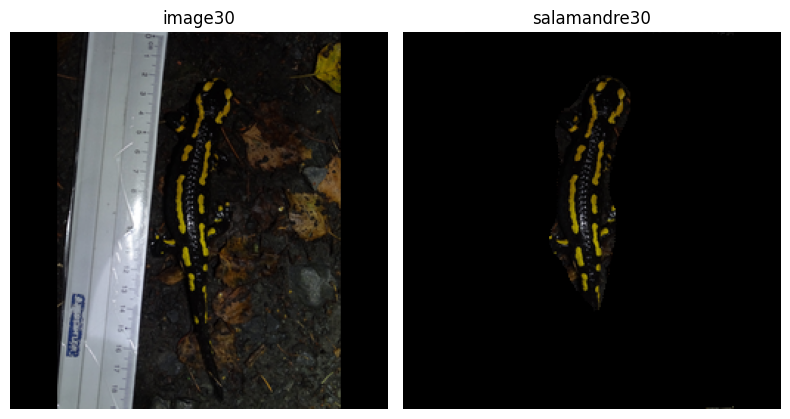

1/1 [==============================] - 2s 2s/step


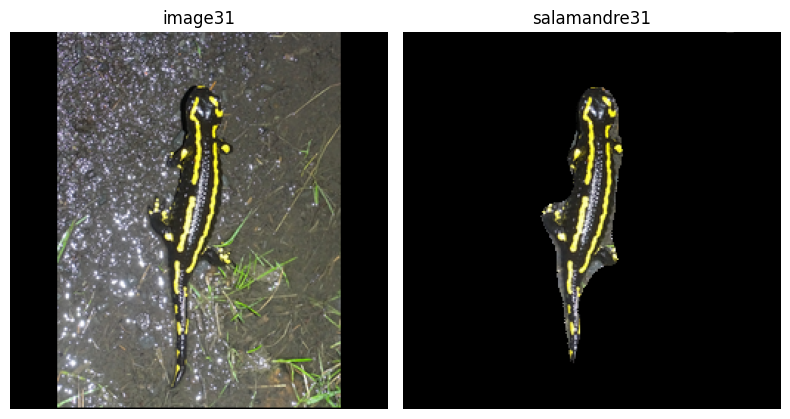

1/1 [==============================] - 2s 2s/step


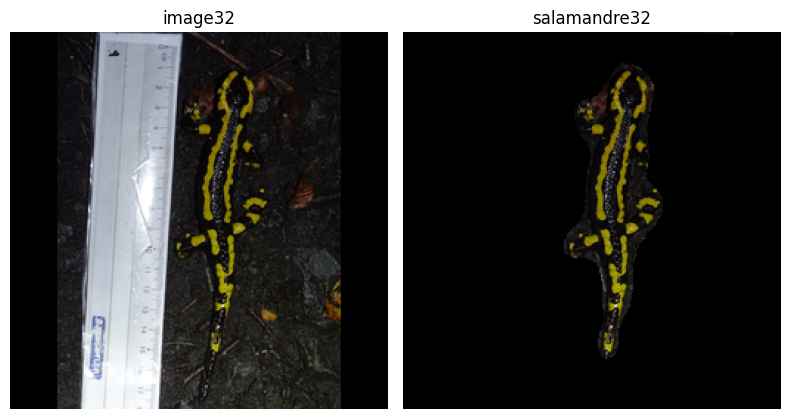

1/1 [==============================] - 2s 2s/step


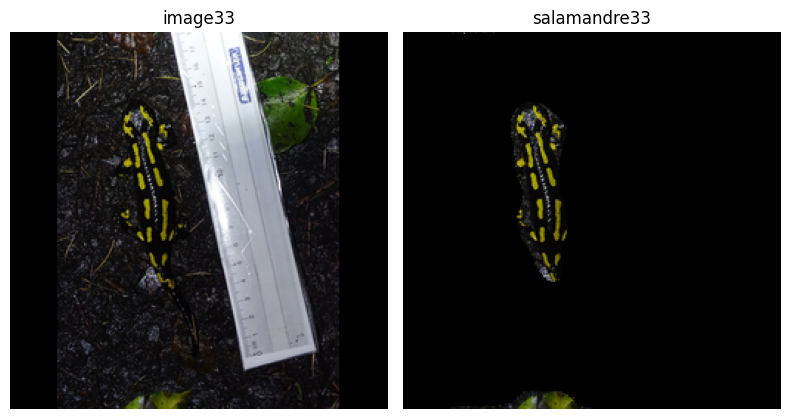

1/1 [==============================] - 2s 2s/step


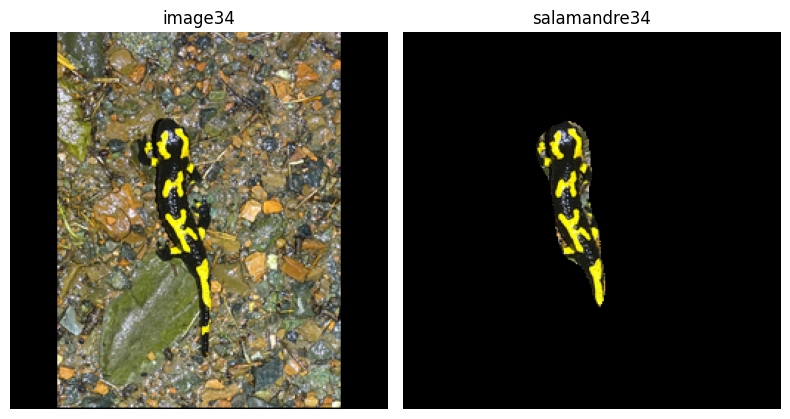

1/1 [==============================] - 4s 4s/step


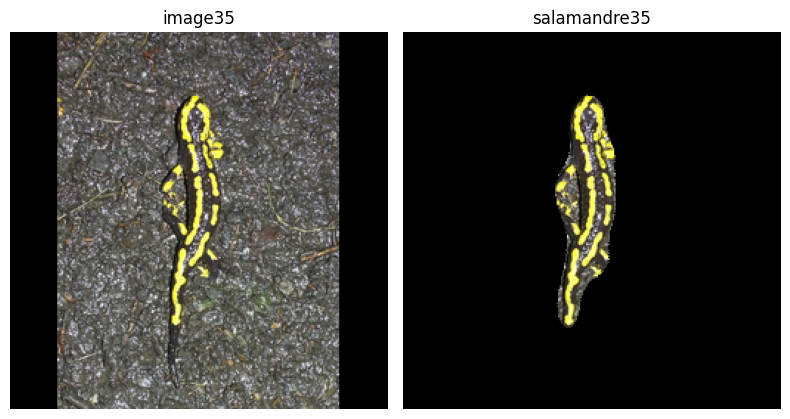

1/1 [==============================] - 2s 2s/step


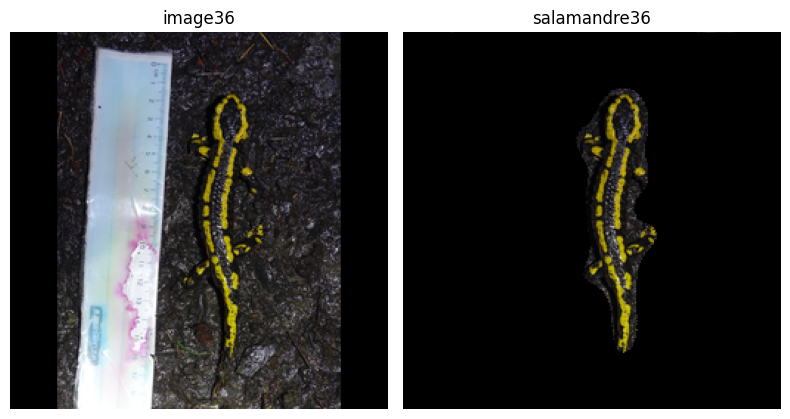

1/1 [==============================] - 2s 2s/step


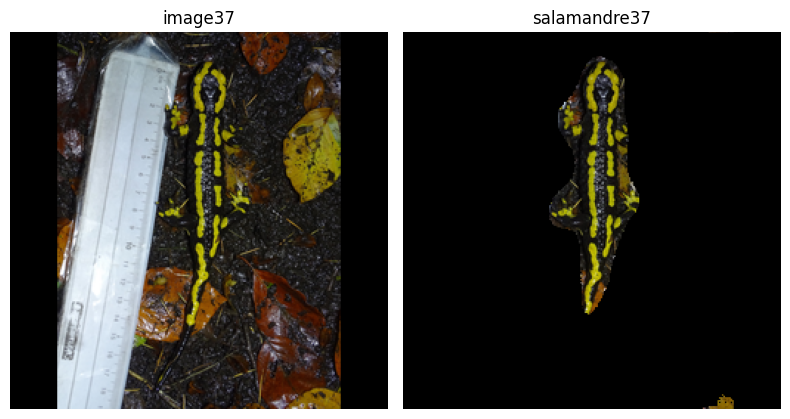

1/1 [==============================] - 2s 2s/step


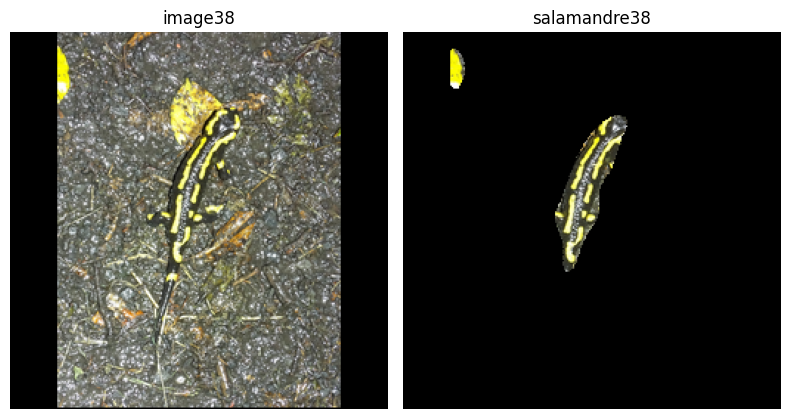

1/1 [==============================] - 2s 2s/step


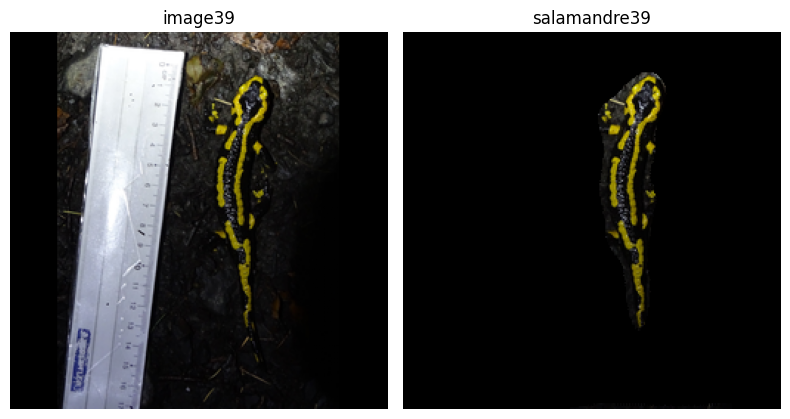

1/1 [==============================] - 3s 3s/step


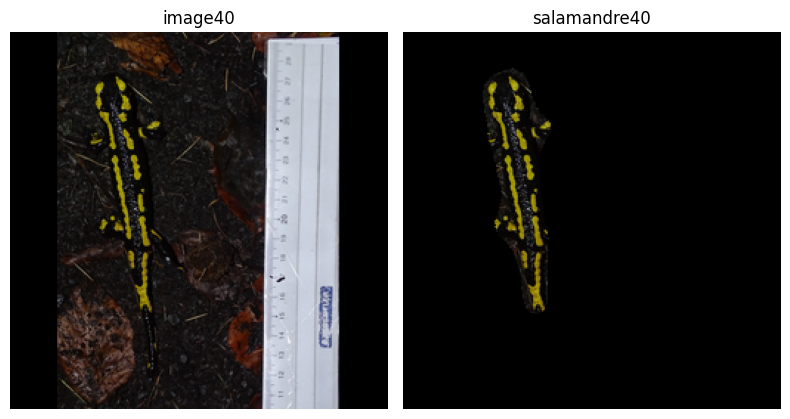

1/1 [==============================] - 3s 3s/step


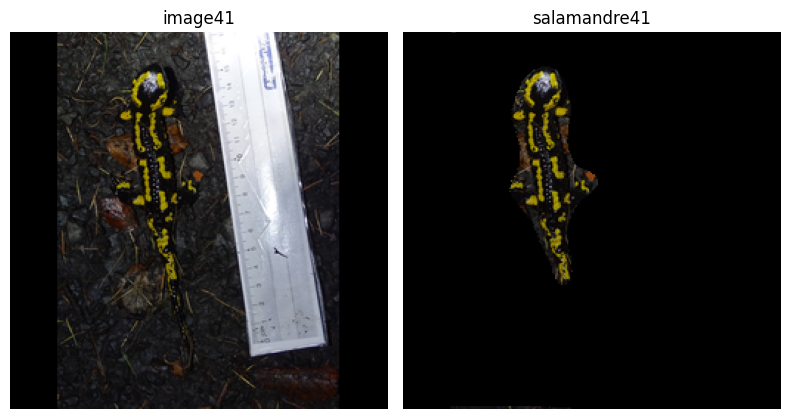

1/1 [==============================] - 2s 2s/step


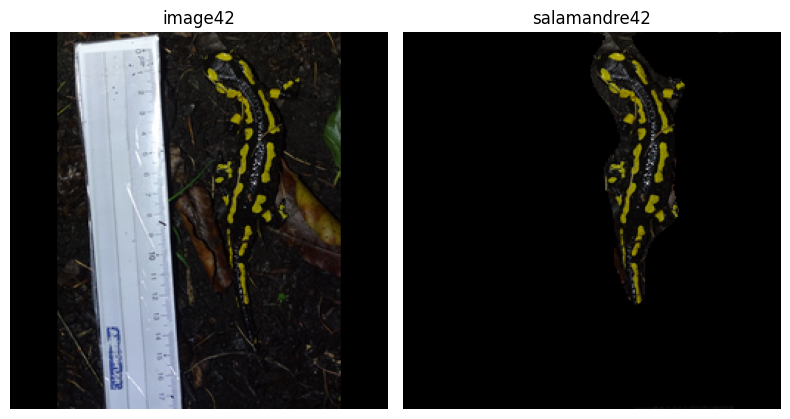

1/1 [==============================] - 2s 2s/step


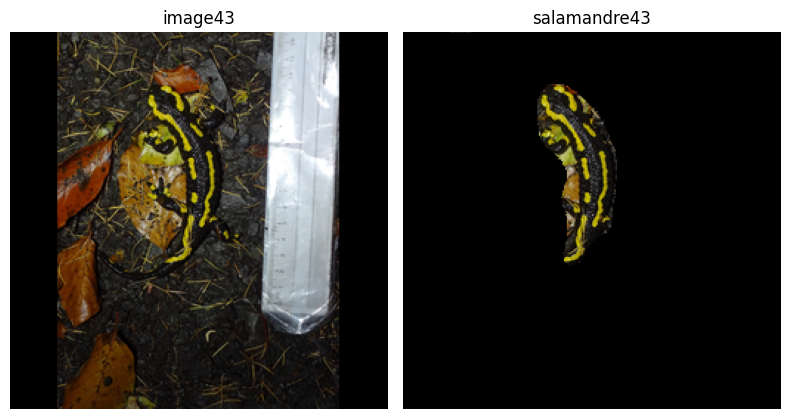

1/1 [==============================] - 2s 2s/step


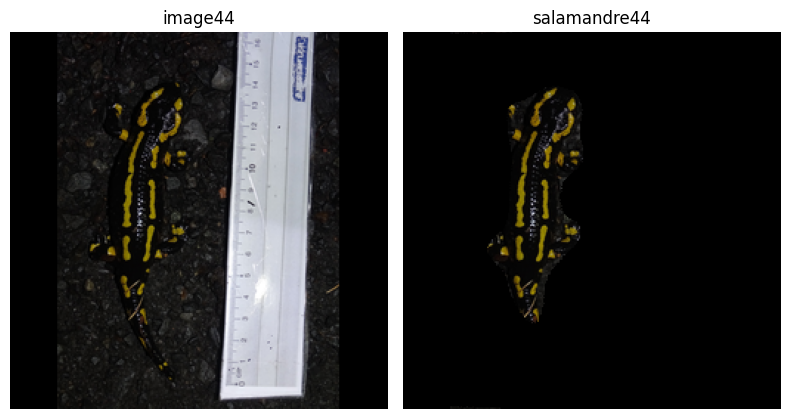

1/1 [==============================] - 2s 2s/step


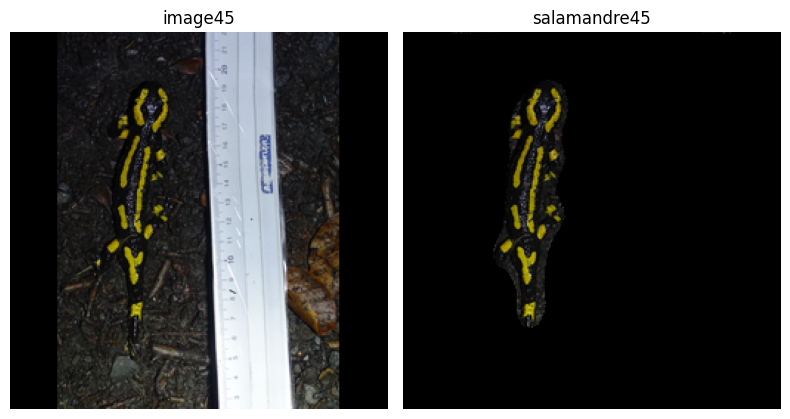

1/1 [==============================] - 3s 3s/step


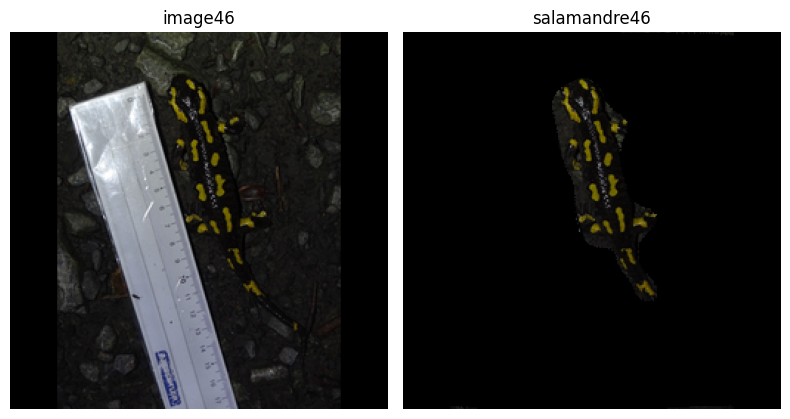

1/1 [==============================] - 2s 2s/step


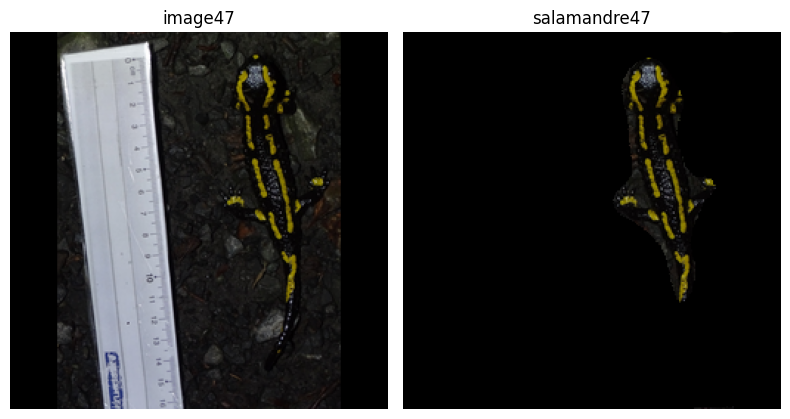

1/1 [==============================] - 2s 2s/step


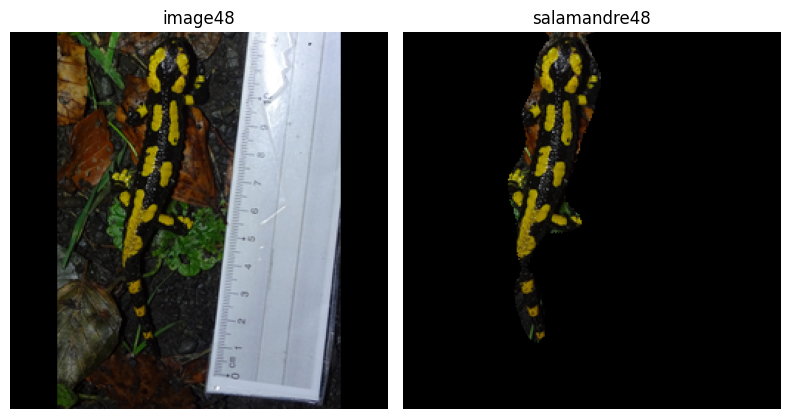

1/1 [==============================] - 2s 2s/step


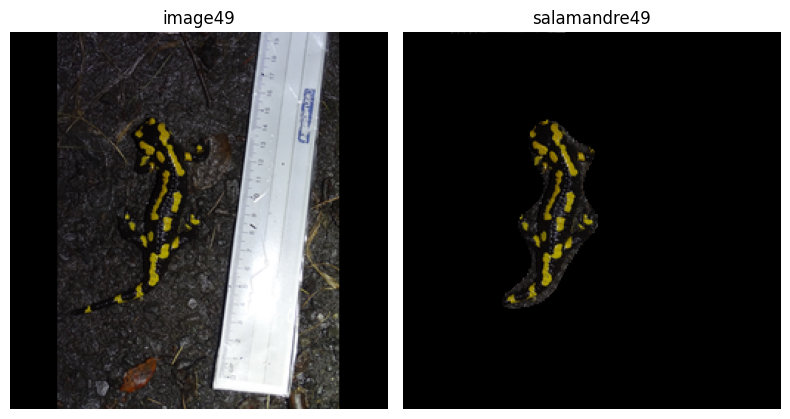

1/1 [==============================] - 2s 2s/step


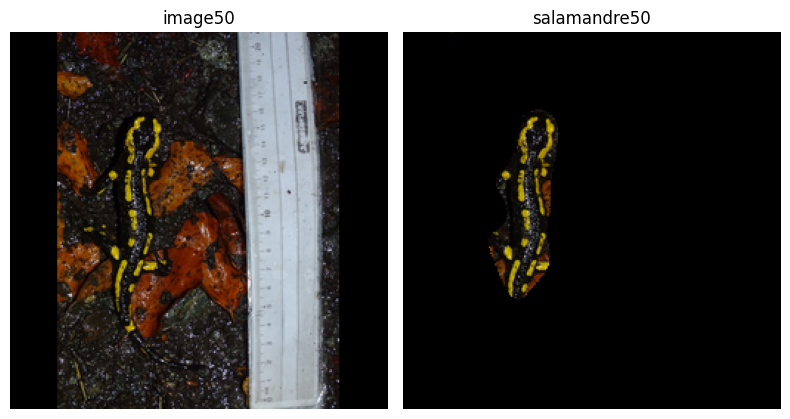

1/1 [==============================] - 3s 3s/step


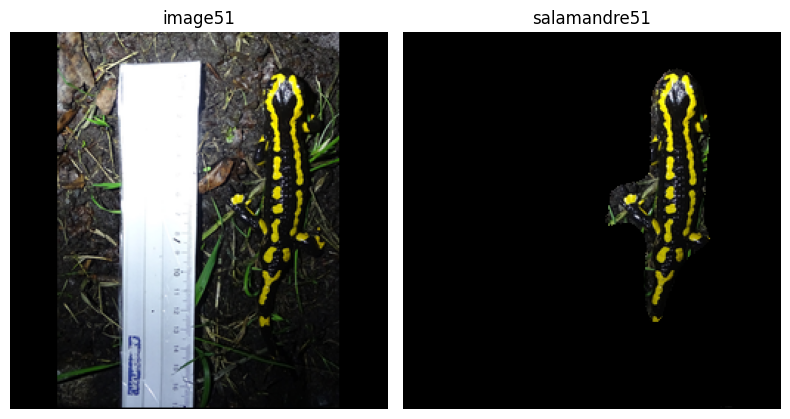

1/1 [==============================] - 3s 3s/step


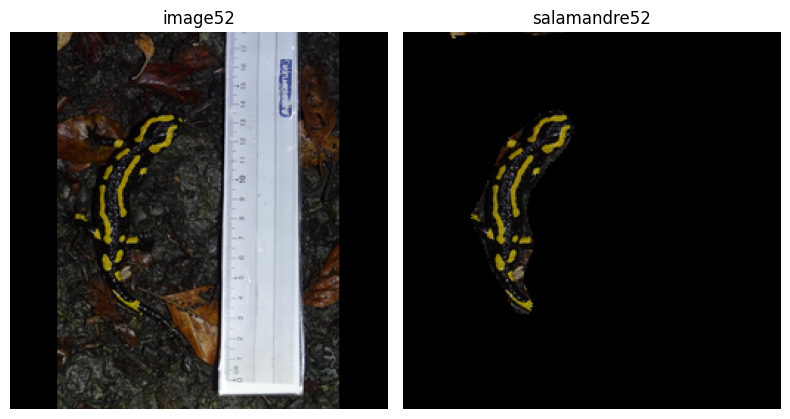

1/1 [==============================] - 2s 2s/step


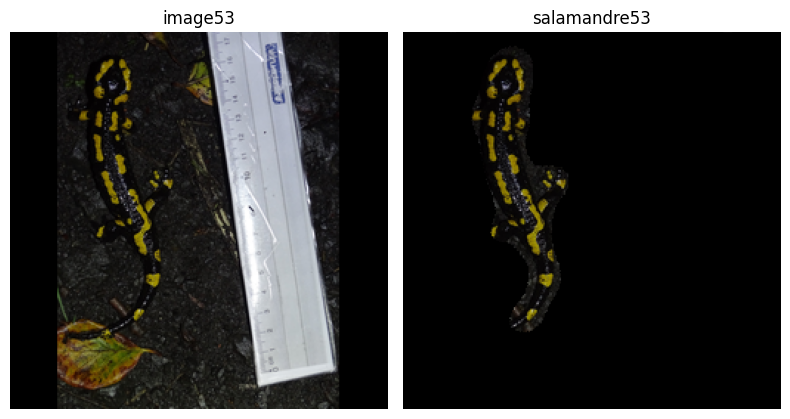

1/1 [==============================] - 2s 2s/step


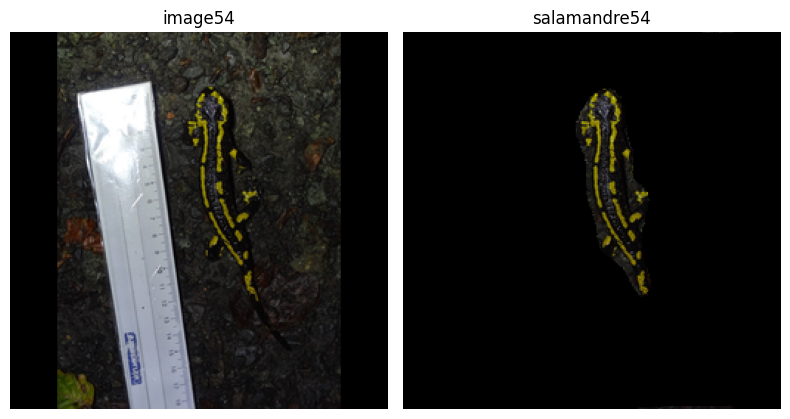

1/1 [==============================] - 2s 2s/step


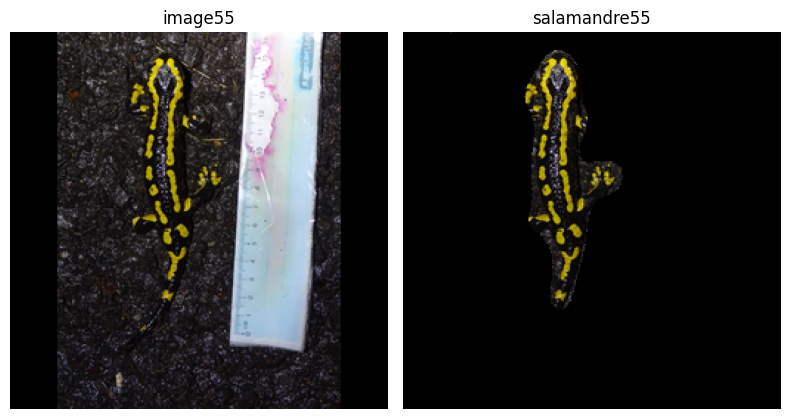

1/1 [==============================] - 3s 3s/step


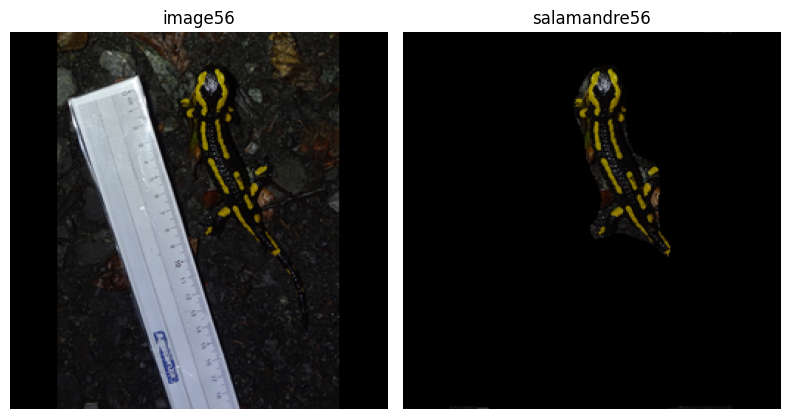

1/1 [==============================] - 3s 3s/step


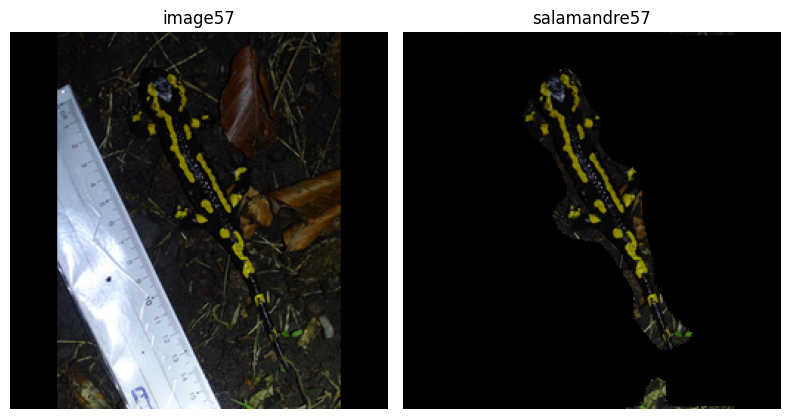

1/1 [==============================] - 2s 2s/step


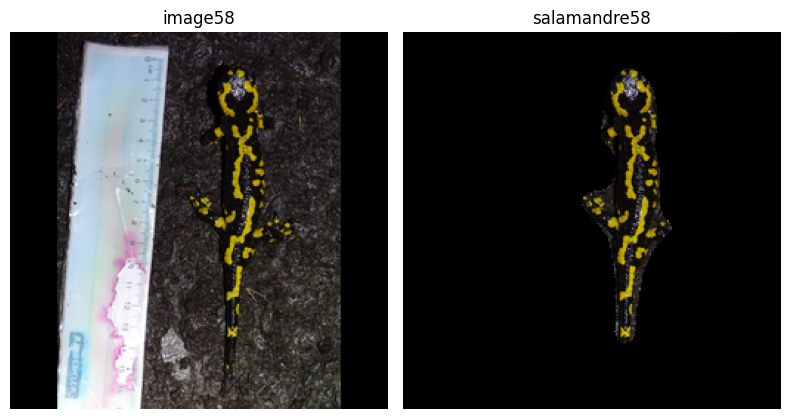

1/1 [==============================] - 2s 2s/step


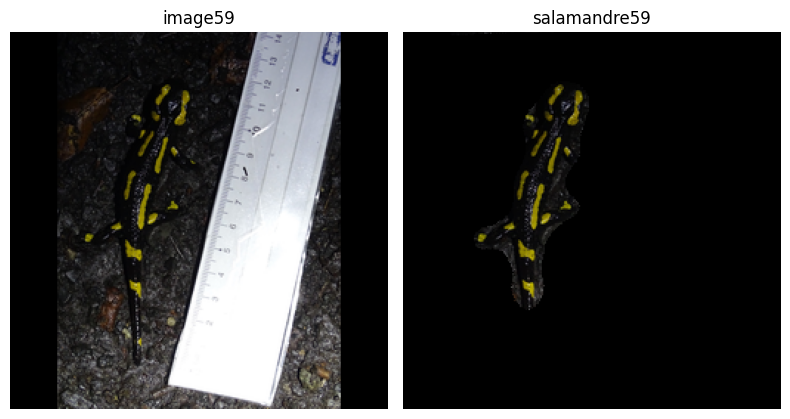

1/1 [==============================] - 2s 2s/step


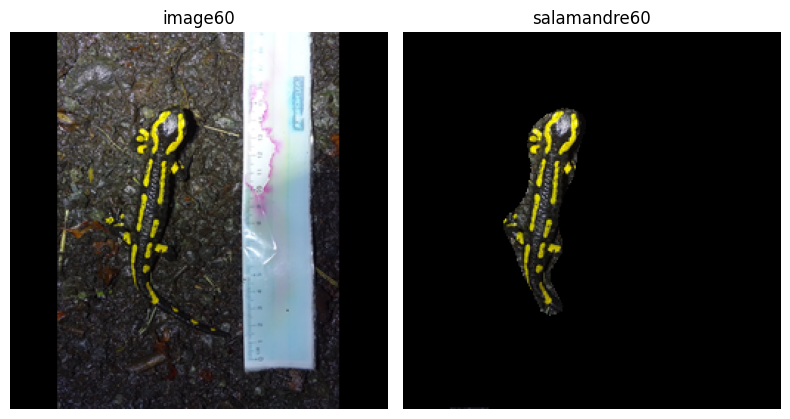

1/1 [==============================] - 3s 3s/step


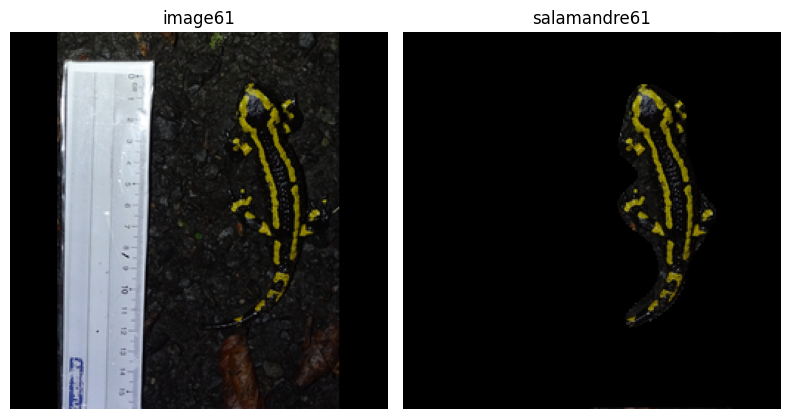

1/1 [==============================] - 3s 3s/step


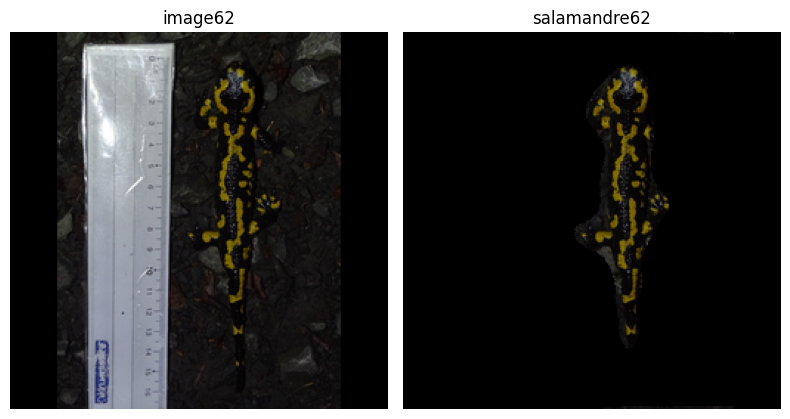

1/1 [==============================] - 2s 2s/step


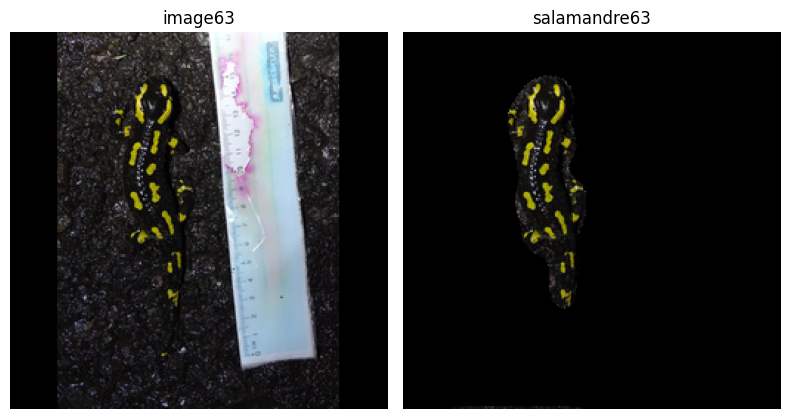

1/1 [==============================] - 2s 2s/step


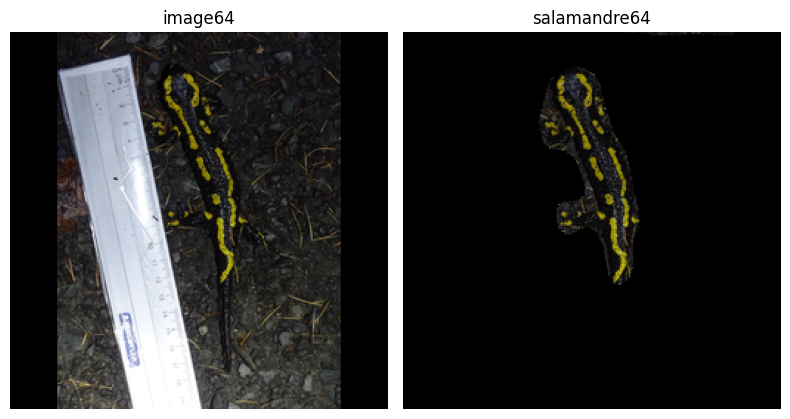

1/1 [==============================] - 2s 2s/step


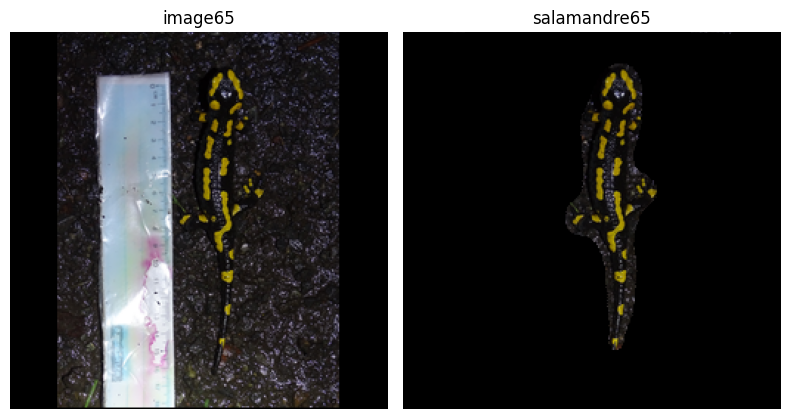

1/1 [==============================] - 3s 3s/step


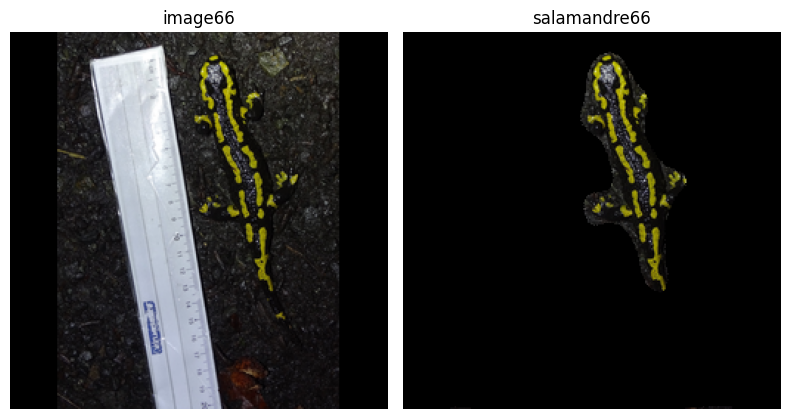

1/1 [==============================] - 2s 2s/step


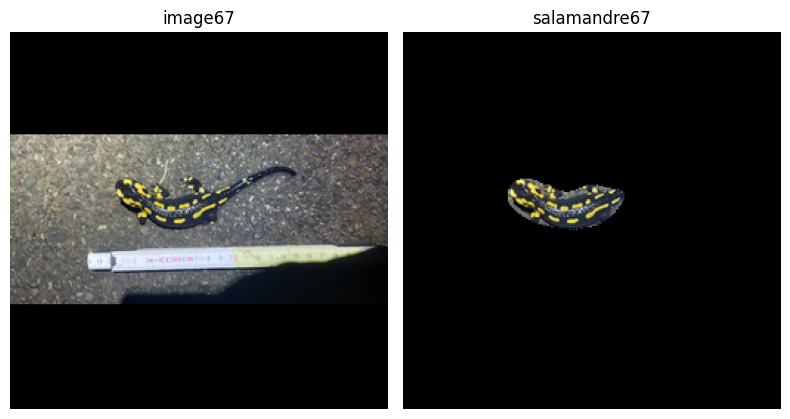

1/1 [==============================] - 2s 2s/step


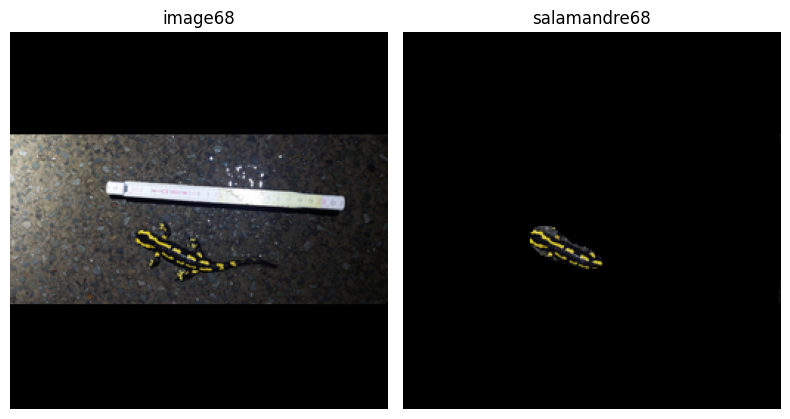

1/1 [==============================] - 2s 2s/step


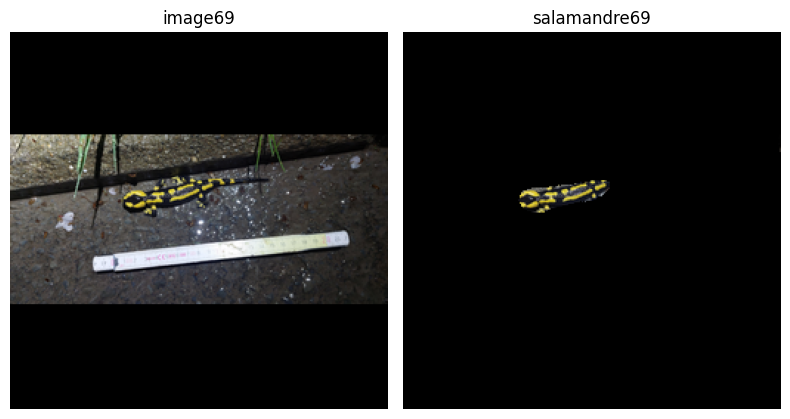

1/1 [==============================] - 3s 3s/step


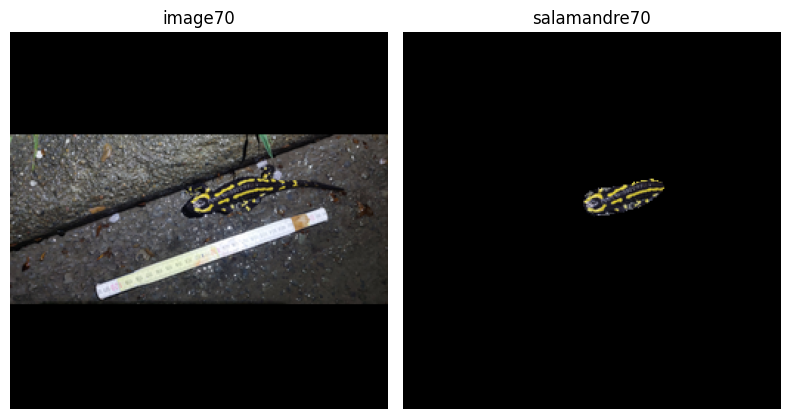

1/1 [==============================] - 3s 3s/step


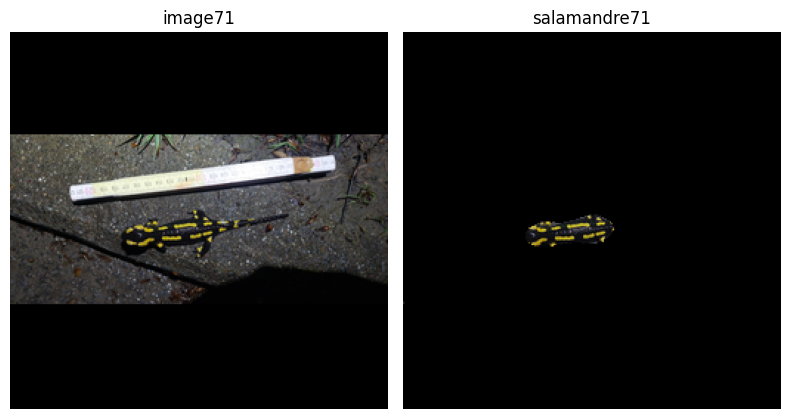

1/1 [==============================] - 2s 2s/step


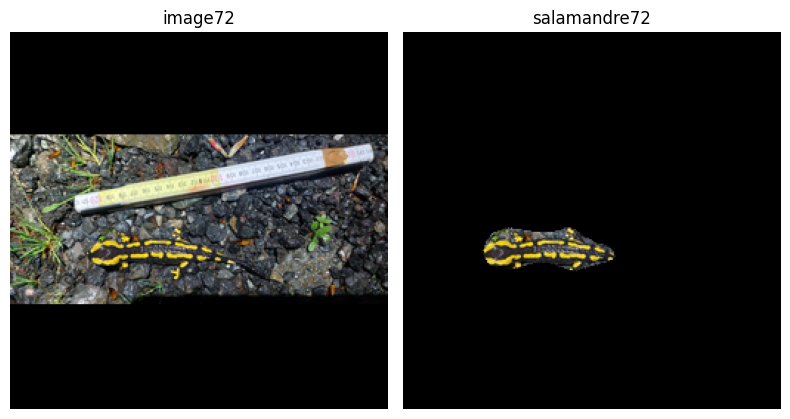

1/1 [==============================] - 2s 2s/step


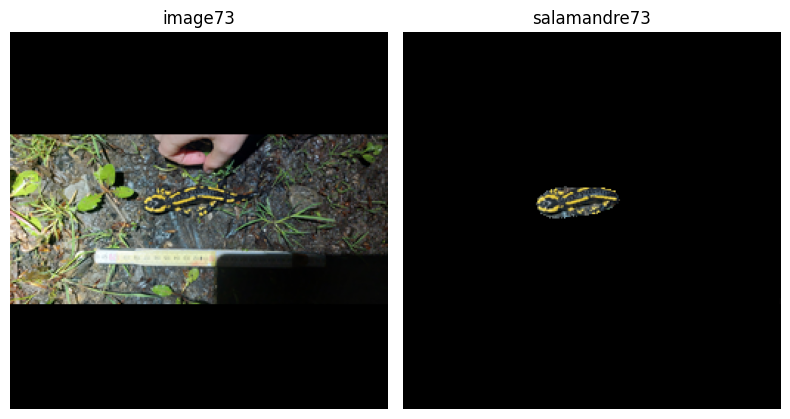

1/1 [==============================] - 2s 2s/step


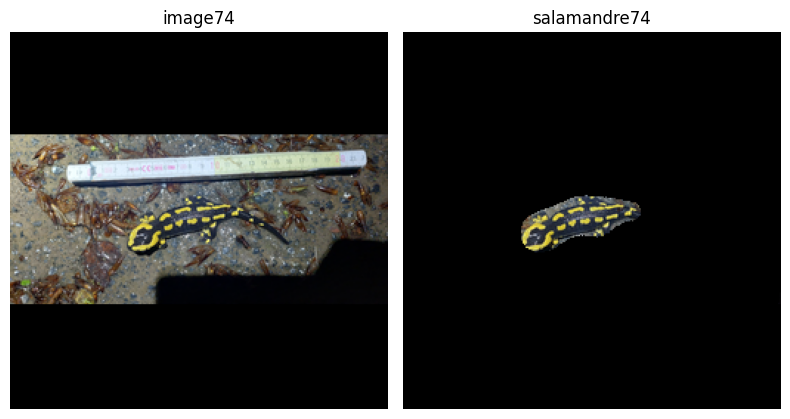

1/1 [==============================] - 3s 3s/step


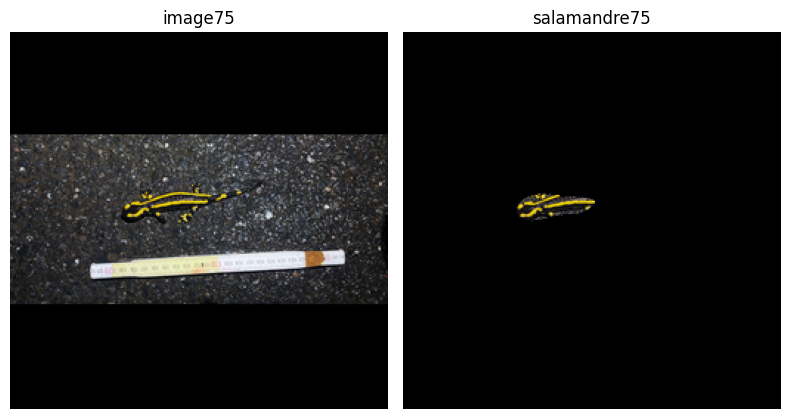

1/1 [==============================] - 4s 4s/step


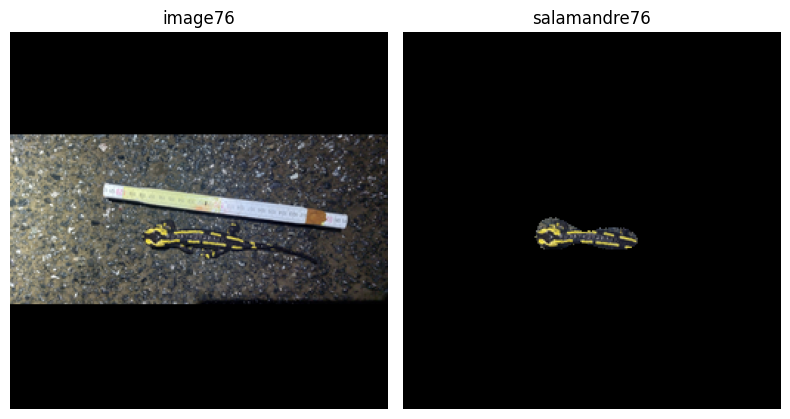

1/1 [==============================] - 2s 2s/step


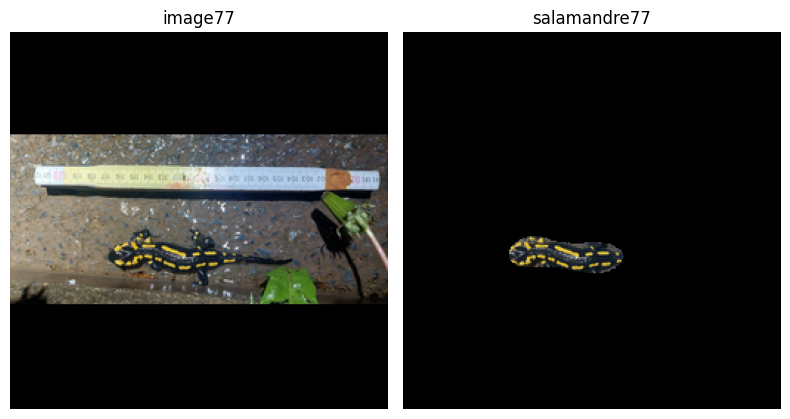

1/1 [==============================] - 2s 2s/step


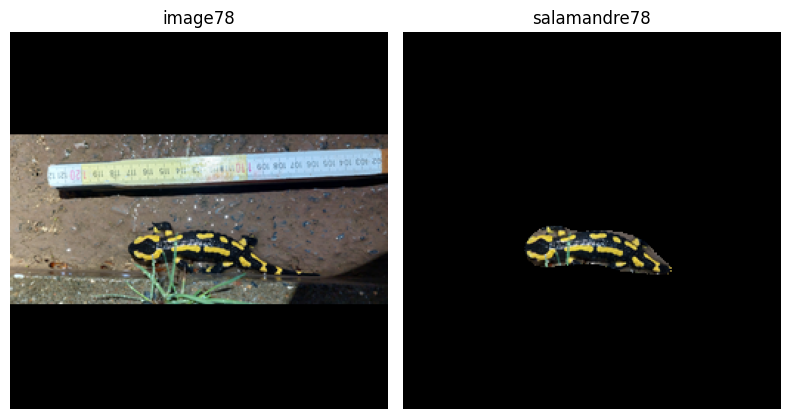

1/1 [==============================] - 2s 2s/step


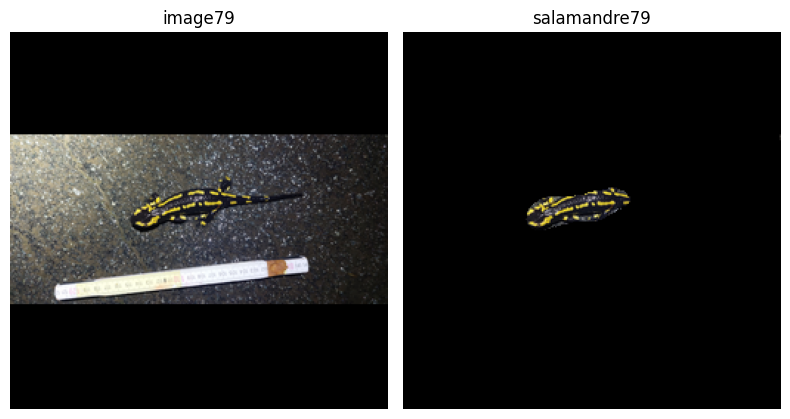

1/1 [==============================] - 2s 2s/step


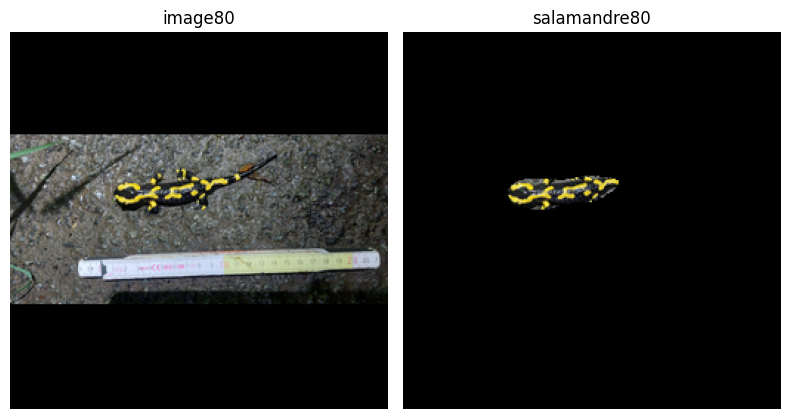

1/1 [==============================] - 4s 4s/step


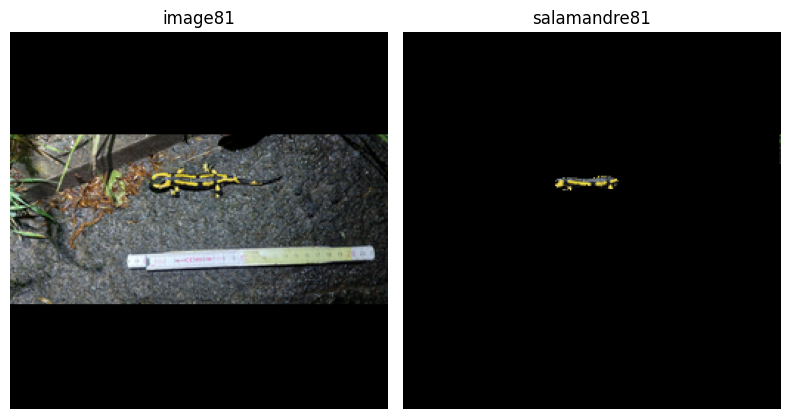

1/1 [==============================] - 2s 2s/step


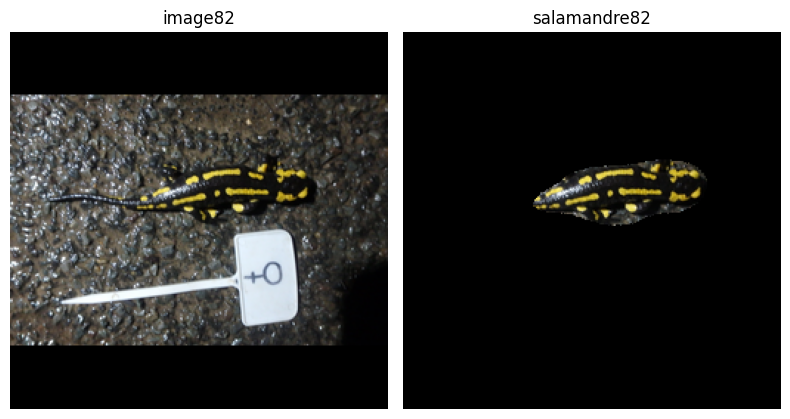

1/1 [==============================] - 2s 2s/step


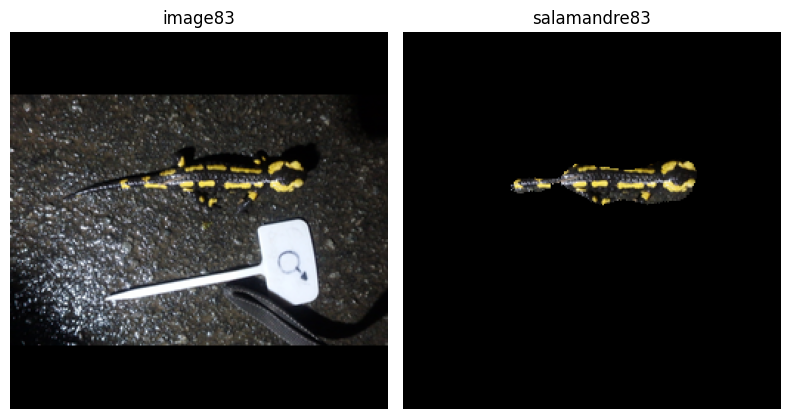

1/1 [==============================] - 2s 2s/step


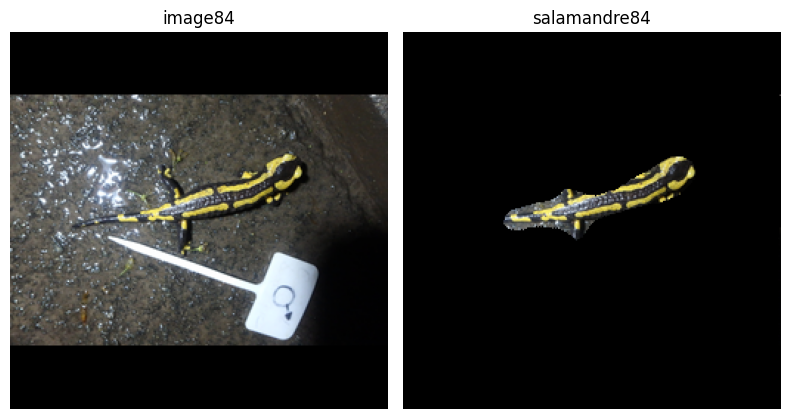

1/1 [==============================] - 2s 2s/step


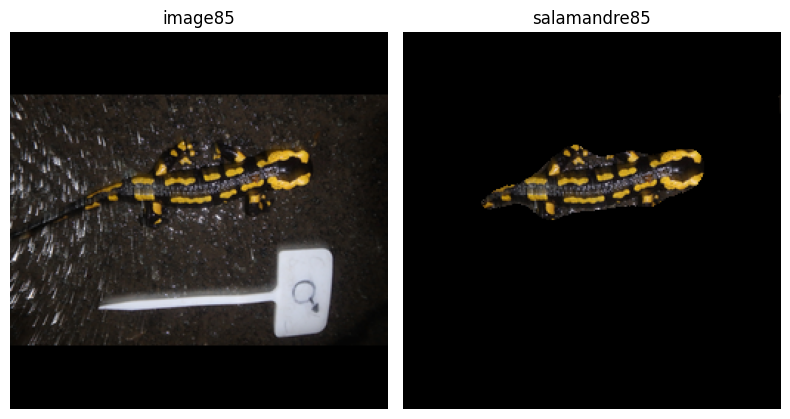

1/1 [==============================] - 4s 4s/step


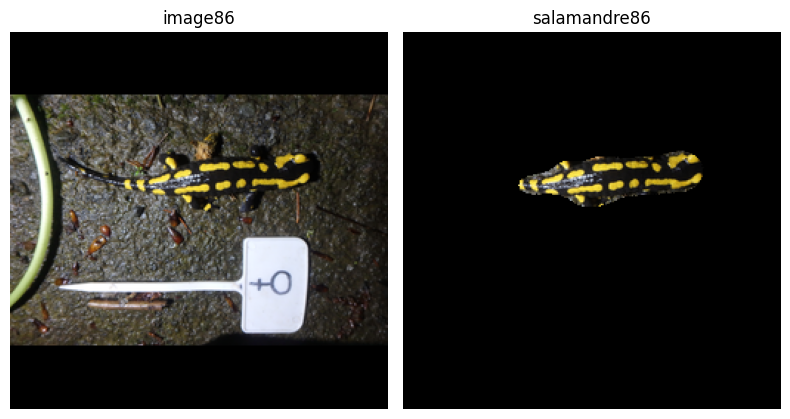

1/1 [==============================] - 3s 3s/step


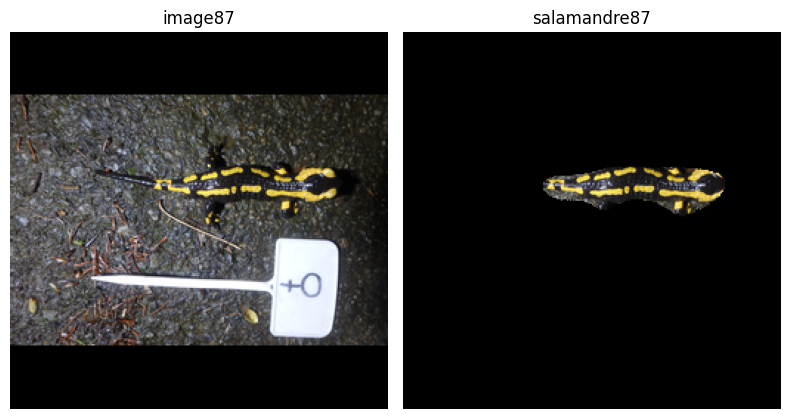

1/1 [==============================] - 2s 2s/step


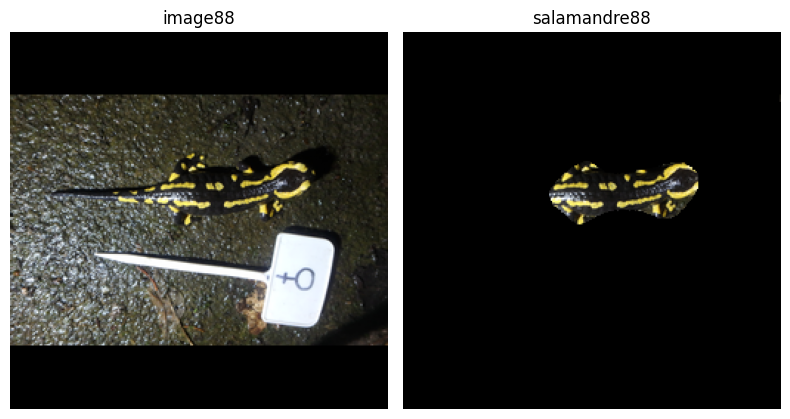

1/1 [==============================] - 2s 2s/step


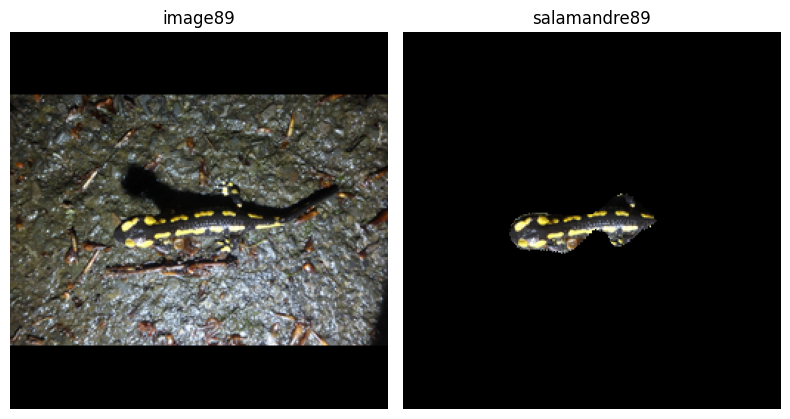

1/1 [==============================] - 2s 2s/step


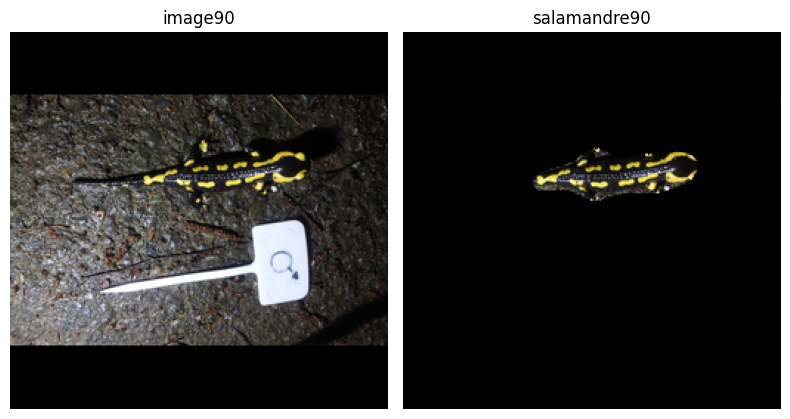

1/1 [==============================] - 3s 3s/step


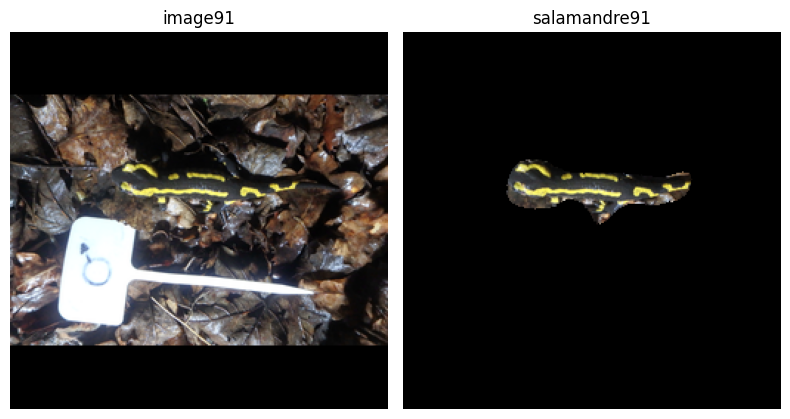

1/1 [==============================] - 3s 3s/step


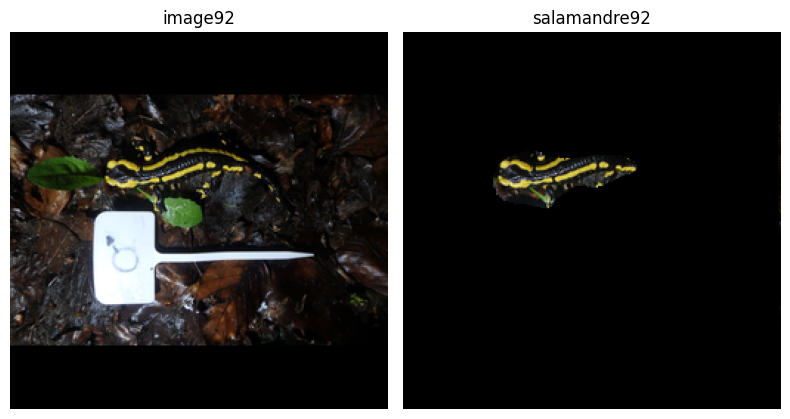

1/1 [==============================] - 2s 2s/step


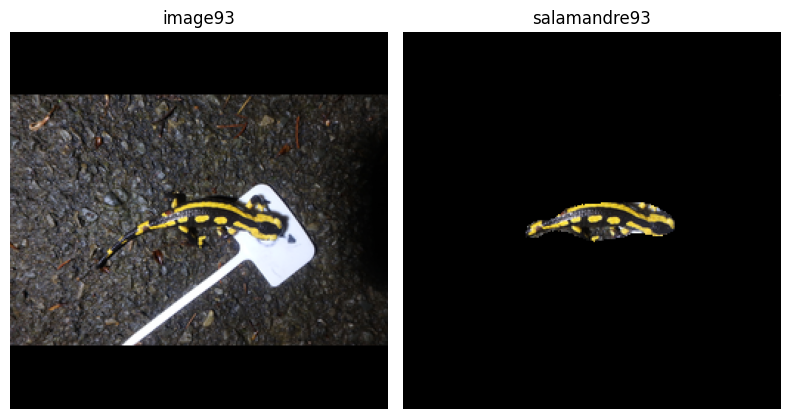

1/1 [==============================] - 2s 2s/step


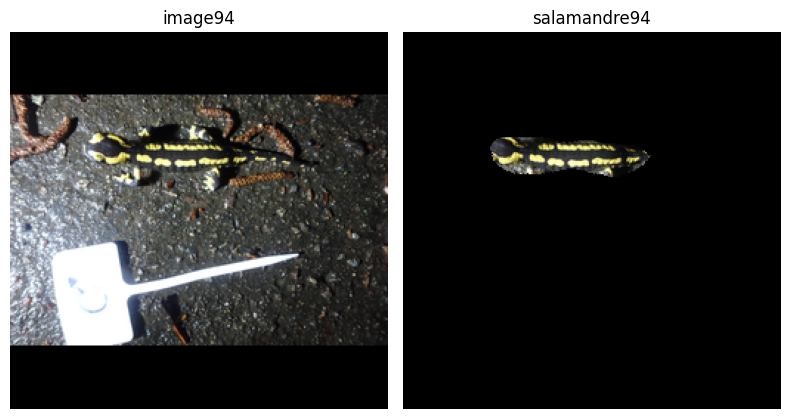

1/1 [==============================] - 2s 2s/step


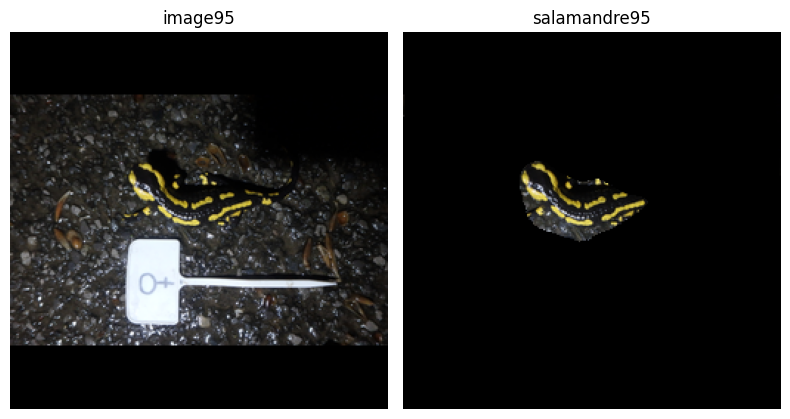

1/1 [==============================] - 3s 3s/step


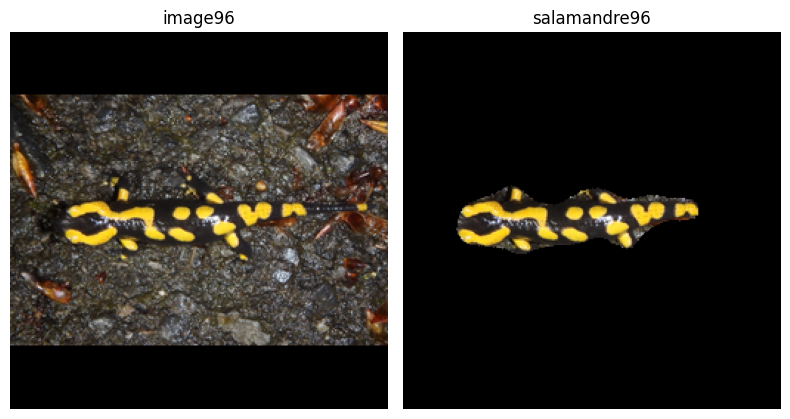

1/1 [==============================] - 3s 3s/step


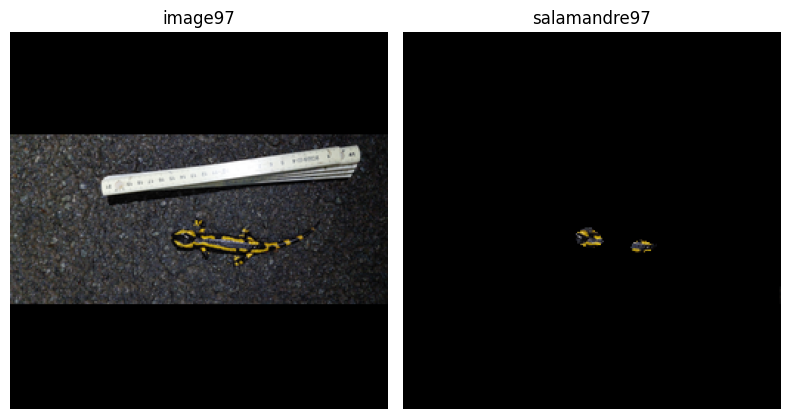

1/1 [==============================] - 2s 2s/step


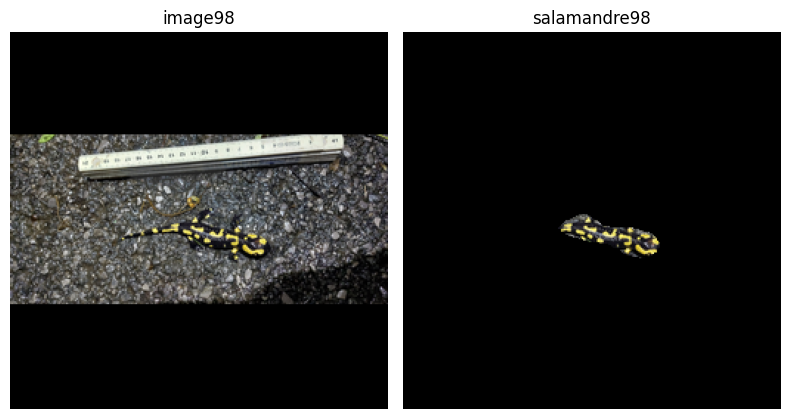

1/1 [==============================] - 2s 2s/step


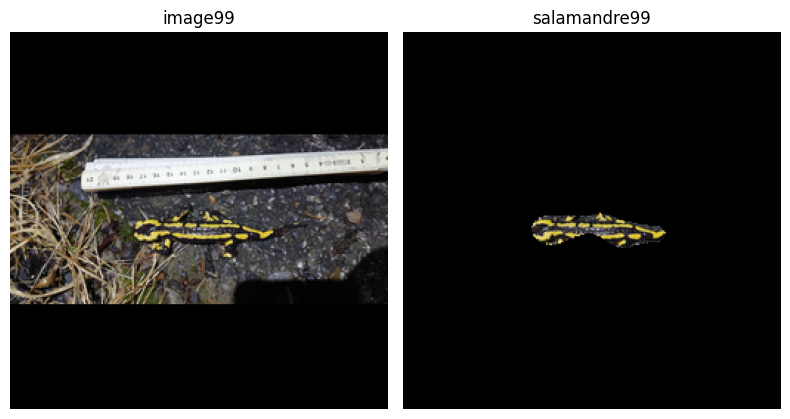

1/1 [==============================] - 2s 2s/step


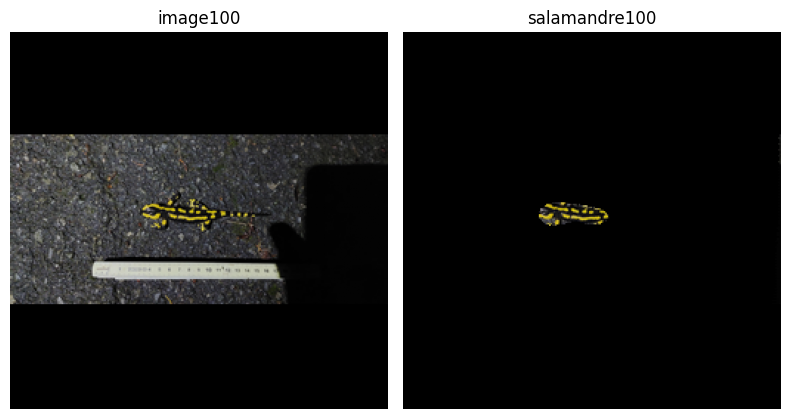

1/1 [==============================] - 4s 4s/step


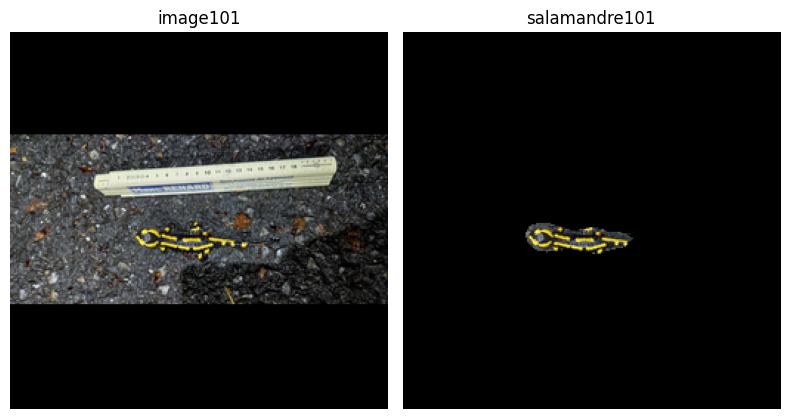

1/1 [==============================] - 3s 3s/step


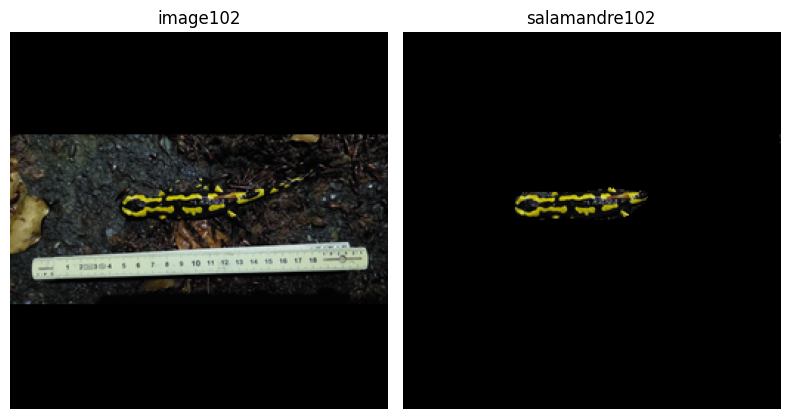

1/1 [==============================] - 2s 2s/step


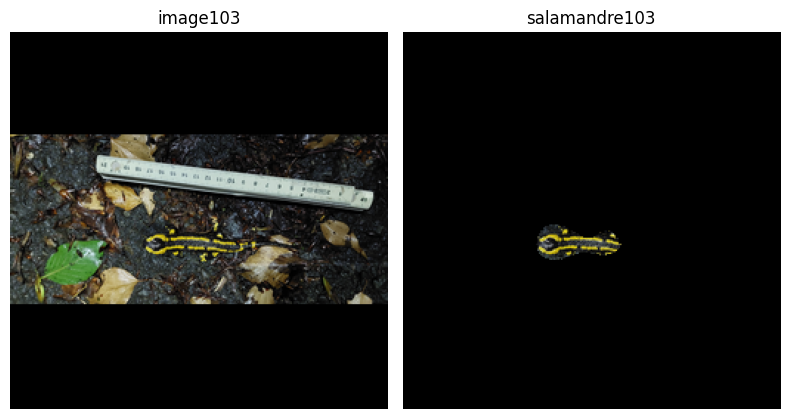

1/1 [==============================] - 2s 2s/step


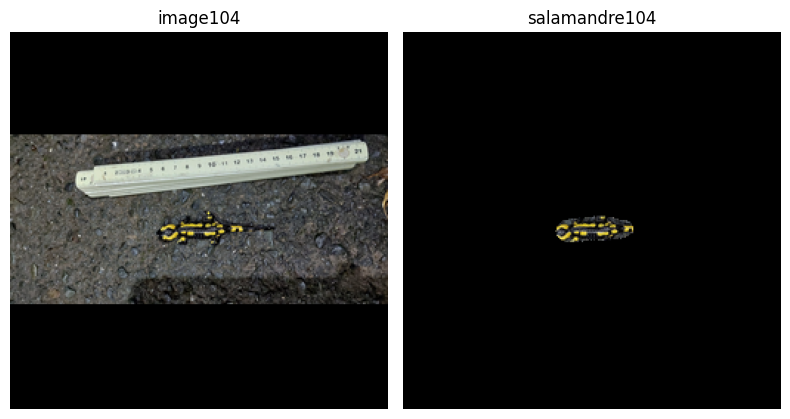

1/1 [==============================] - 2s 2s/step


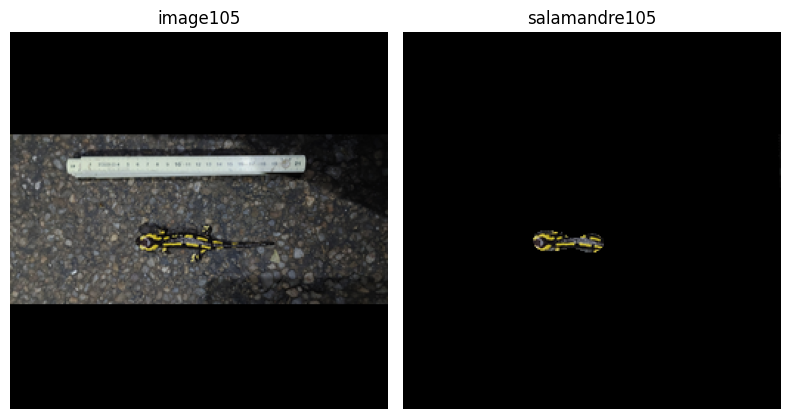

1/1 [==============================] - 3s 3s/step


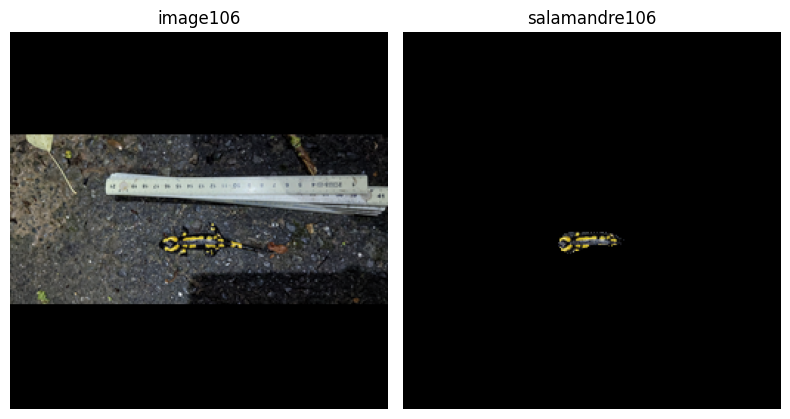

1/1 [==============================] - 3s 3s/step


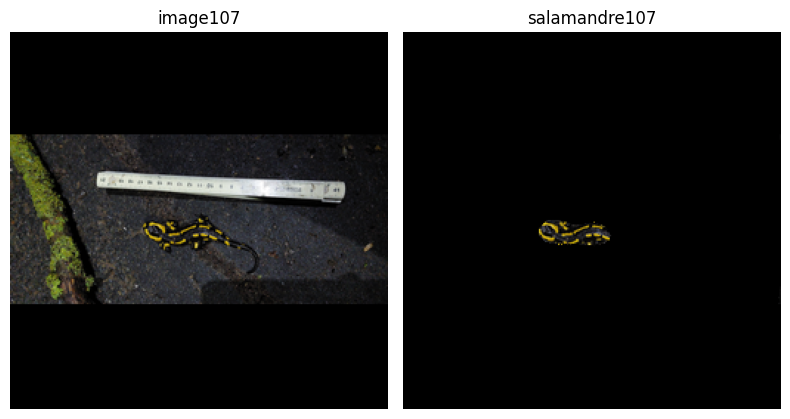

1/1 [==============================] - 2s 2s/step


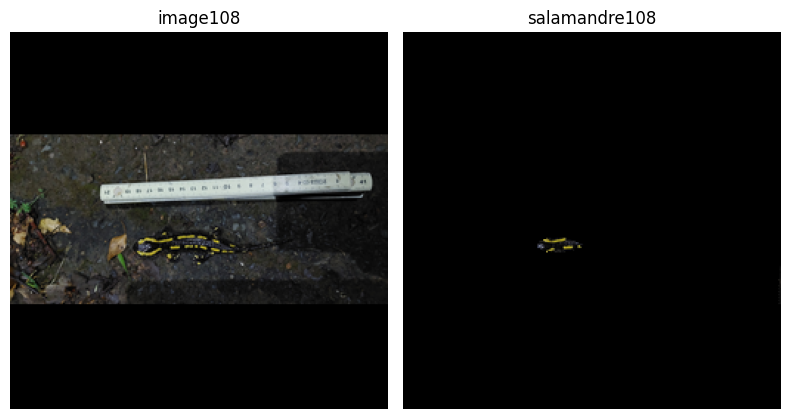

1/1 [==============================] - 2s 2s/step


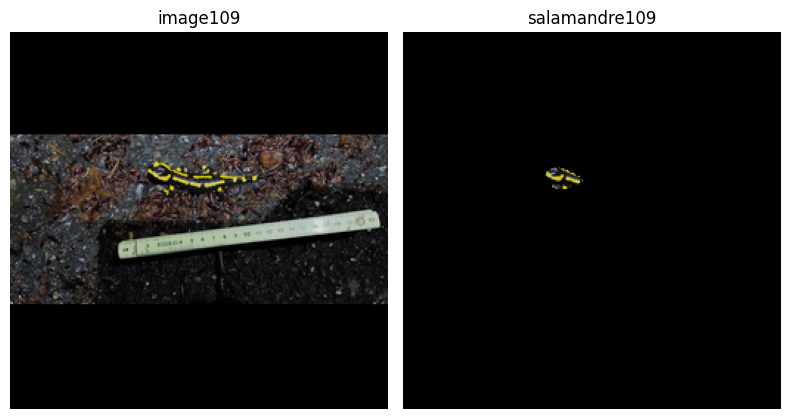

1/1 [==============================] - 2s 2s/step


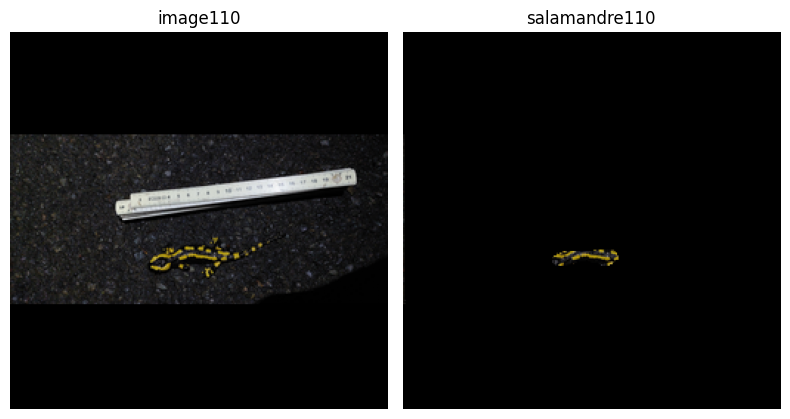

1/1 [==============================] - 3s 3s/step


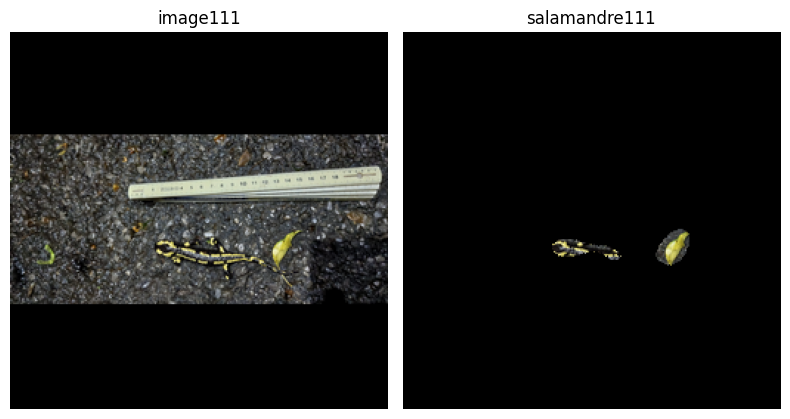

In [ ]:
# plot results
collected_masks=[]
for i in range(len(data)):

  original = data[i].copy()
  mask = loaded_model.predict(np.expand_dims(original,axis=0))

  filtered_mask = remove_outliers(mask[0], min_size=100)
  mask = dilation(mask[0])

  segmented = np.squeeze(original).copy()
  segmented[np.squeeze(mask )<0.3] = 0

  filtered_segmented=np.squeeze(original).copy()
  filtered_segmented[np.squeeze(filtered_mask) <0.3] = 0

  fig = plt.figure(figsize=(8,6))

  plt.subplot(1,2,1)
  plt.imshow(np.squeeze(original))
  plt.title("image"+str(i))
  plt.axis("off")

  plt.subplot(1,2,2)
  plt.imshow(filtered_segmented,cmap="gray")
  plt.title("salamandre"+str(i))
  plt.axis("off")


  fig.tight_layout()
  plt.show()
  figure_file_name="segmented_img"+str(i)+".png"
  collected_masks.append(mask)
  plt.imsave("/content/prediction_img/"+figure_file_name,segmented)

! zip -rq /content/segmentation_salamandres.zip /content/prediction_img